In [1]:
import gffutils
import pickle
from overlap_calc import *
mouse_db = gffutils.FeatureDB('mouse.db')
mouse_canons = list(g for g in gffutils.helpers.canonical_transcripts(mouse_db, r'/mnt/hddata/2/evgeny/TAU/Mus_musculus.GRCm38.dna_sm.primary_assembly.fa') if g[0].attributes['biotype'][0] == 'protein_coding')
cpgs_mouse = load_cpg_gff(mouse_db)
#cpgs_mouse = load_cpg_bed('/home/evgeny/tau/gen_cpg/mm_liver_nmi.bed')
mouse_overlap = cpg_overlap(mouse_canons, cpgs_mouse, pre_tss=300, post_tss=100)
canons = canons_by_gene(mouse_db, r'/mnt/hddata/2/evgeny/TAU/Mus_musculus.GRCm38.dna_sm.primary_assembly.fa', nc=False)

In [2]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

In [3]:
from itertools import groupby
from pandas import DataFrame, concat, read_csv
from csv import DictReader
gene_ids = {t.id[11:] : t.attributes['Parent'][0][5:] for t in mouse_db.features_of_type('mRNA')}
mean_tpm = DataFrame()
for t in dict({r[0] : [x[0] for x in r[1]] for r in groupby(sorted([(r['Run'], r['Tissue'], r['sex']) for r in DictReader(open('/data/db/import/sra/SraRunTable.csv', 'r'))], key=lambda x: (x[1], x[2])), lambda x: (x[1], x[2]))}).items():
    cnts_ar = []
    for run in t[1]:
        cnts_ar.append(read_csv('/data/db/import/sra/'+run+'_quant/quant.sf', delimiter='\t').assign(ID=lambda x: [gene_ids[r['Name'].split('.')[0]] if r['Name'].split('.')[0] in gene_ids else None for r in x.iloc]).dropna()[['ID', 'TPM']])
    cnts = concat([c.groupby(['ID']).mean() for c in cnts_ar]).rename(columns={'TPM' : '%s-%s-tpm'%t[0]})
    mean_tpm = mean_tpm.join(cnts.groupby(['ID']).mean(), how='outer')
        

In [4]:
from pandas import DataFrame
genexpr=mean_tpm


In [5]:
from homologs import paralogs
paralogs=paralogs(gffutils.FeatureDB('mouse.db'), r'/mnt/hddata/2/evgeny/TAU/Mus_musculus.GRCm38.dna_sm.primary_assembly.fa', '10090')

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

In [6]:
import importlib
import overlap_calc
importlib.reload(overlap_calc)

<module 'overlap_calc' from '/home/gencpg/gen_cpg/overlap_calc.py'>

In [7]:
from homologs import orthologs_by_gene
o2os = orthologs_by_gene(mouse_overlap.keys())

In [8]:
cpg_less, cpg_full = [set(s) for s in split_overlaps(mouse_overlap)]

In [9]:
genexpr['cpgness'] = [mouse_overlap['gene:'+g] if 'gene:'+g in mouse_overlap else None for g in genexpr.index]
genexpr['cpgfull'] = [g>=0.5 for g in genexpr['cpgness']]
genexpr = genexpr.dropna()

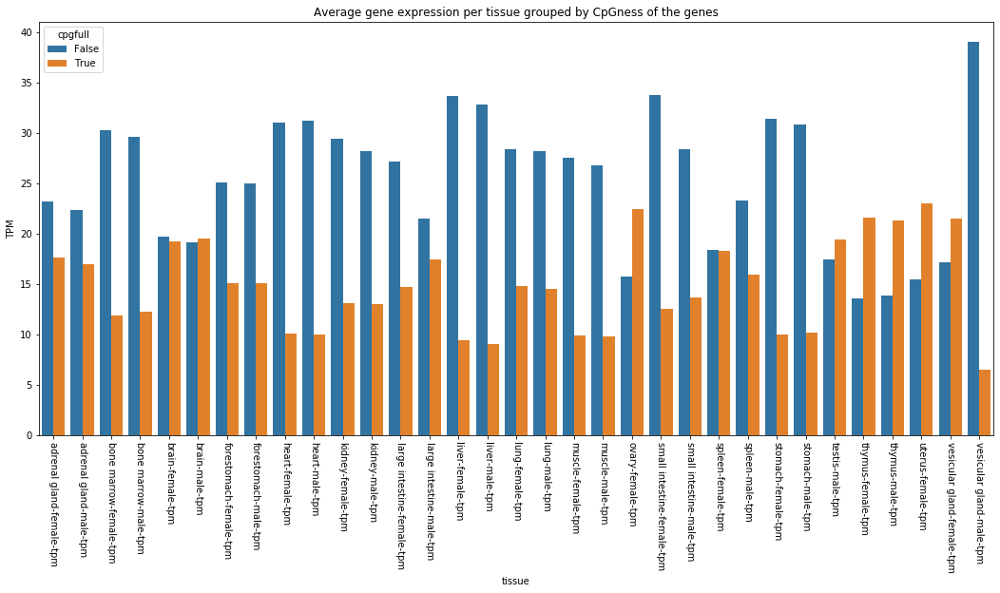

In [10]:
from seaborn import barplot
from matplotlib import pyplot 
fig, ax = pyplot.subplots(figsize=(18,8))
pyplot.xticks(rotation=-90)
#gen_exp
avgexpr=genexpr.melt(id_vars=['cpgfull'], value_vars=set(genexpr.columns).difference(['cpgness', 'cpgfull'])).groupby(['variable', 'cpgfull'], as_index=False).mean()
barplot(ax=ax, hue='cpgfull',x='variable', y='value', data=avgexpr)
pyplot.ylabel('TPM')
pyplot.xlabel('tissue')
pyplot.title('Average gene expression per tissue grouped by CpGness of the genes')
pyplot.show()

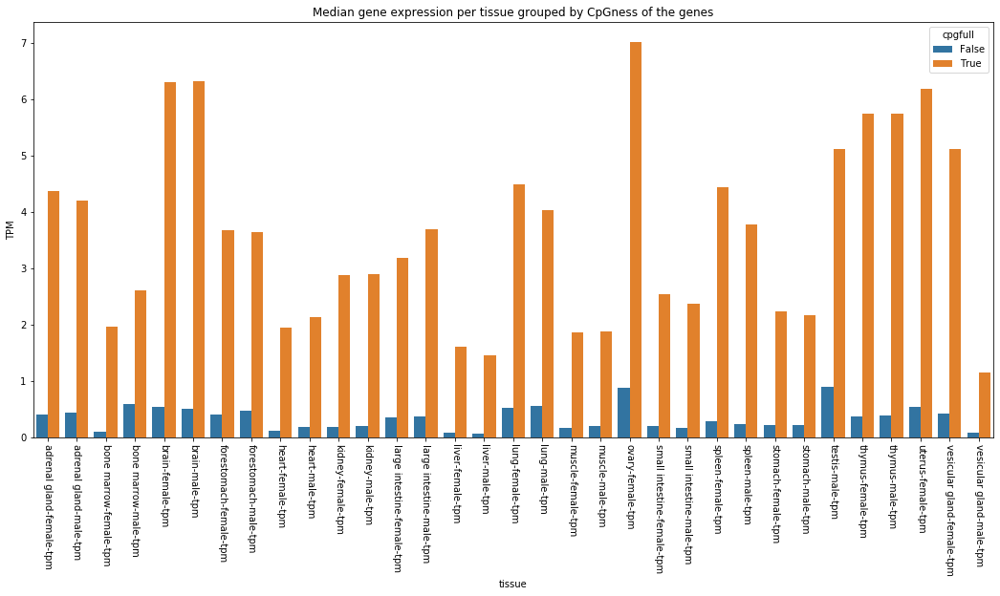

In [11]:
from seaborn import barplot
from matplotlib import pyplot 
fig, ax = pyplot.subplots(figsize=(18,8))
pyplot.xticks(rotation=-90)
#gen_exp
avgexpr=genexpr.melt(id_vars=['cpgfull'], value_vars=set(genexpr.columns).difference(['cpgness', 'cpgfull'])).groupby(['variable', 'cpgfull'], as_index=False).median()
barplot(ax=ax, hue='cpgfull',x='variable', y='value', data=avgexpr)
pyplot.ylabel('TPM')
pyplot.xlabel('tissue')
pyplot.title('Median gene expression per tissue grouped by CpGness of the genes')
pyplot.show()

/home/gencpg/.local/lib/python3.8/site-packages/seaborn/categorical.py:470: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  artist_dict = ax.boxplot(box_data,


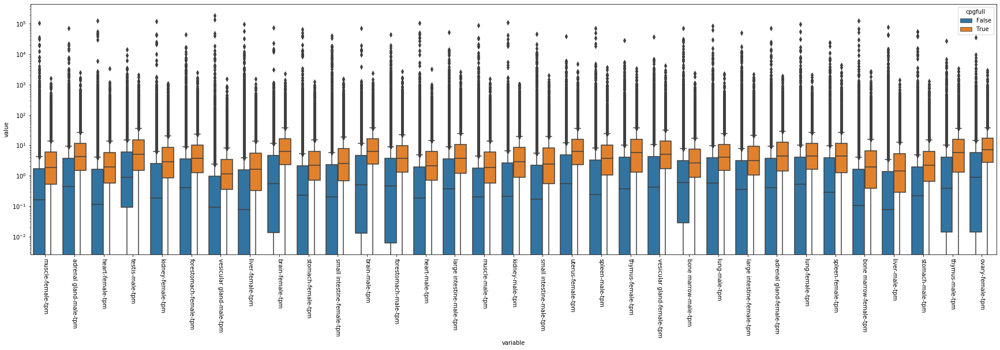

In [12]:
from seaborn import boxplot
from matplotlib import pyplot 
fig, ax = pyplot.subplots(figsize=(30,8))
ax.set_yscale('log')
pyplot.xticks(rotation=-90)
boxplot(ax=ax,data=genexpr.melt(id_vars=['cpgfull'], value_vars=set(genexpr.columns).difference(['cpgness', 'cpgfull'])), x='variable', hue='cpgfull', y='value')

/usr/lib/python3/dist-packages/matplotlib/cbook/__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  ndim = x[:, None].ndim
/usr/lib/python3/dist-packages/matplotlib/axes/_base.py:276: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
/usr/lib/python3/dist-packages/matplotlib/axes/_base.py:278: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]
/usr/lib/python3/dist-packages/matplotlib/cbook/__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version

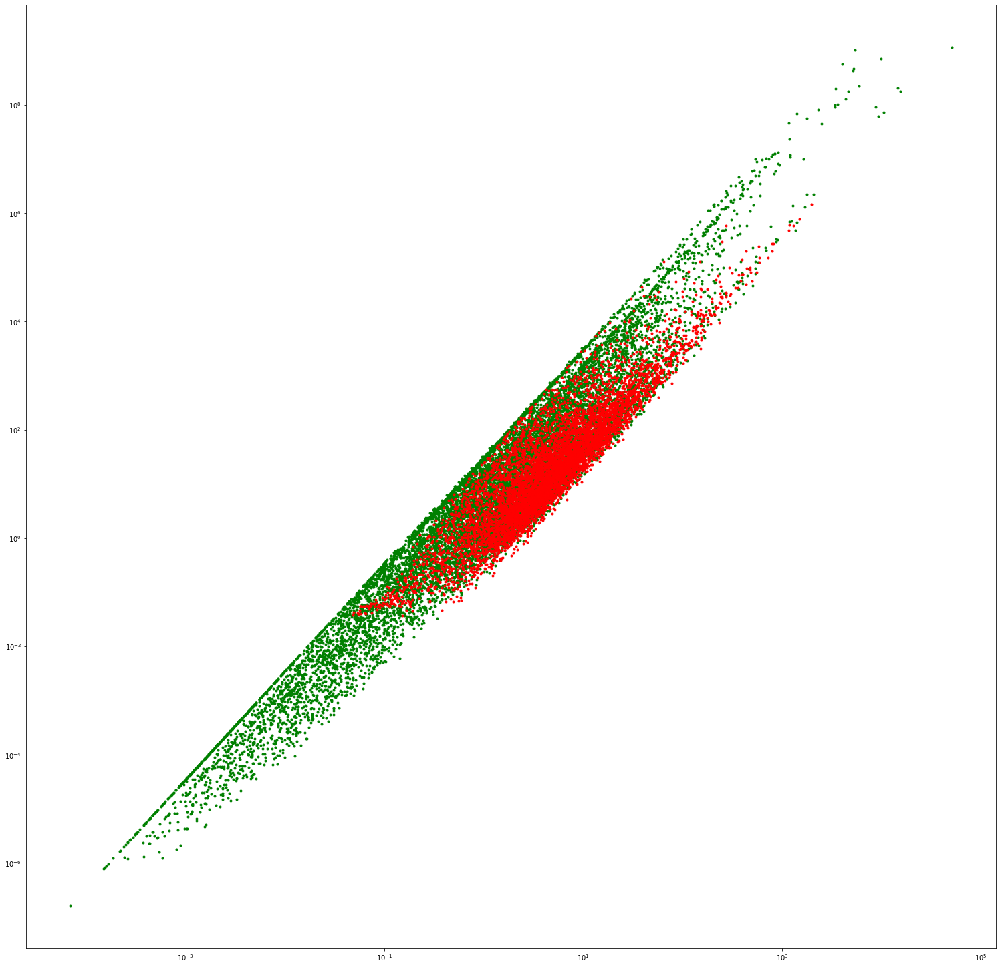

In [13]:
exp_less, exp_full=genexpr[genexpr['cpgness'] < 0.5], genexpr[genexpr['cpgness'] >= 0.5]
fig, ax = pyplot.subplots(figsize=(26,26))
pyplot.xscale('log')
pyplot.yscale('log')
pyplot.plot(exp_less.groupby(exp_less.index).sum().T.mean(), exp_less.groupby(exp_less.index).sum().T.var(), 'g.')
pyplot.plot(exp_full.groupby(exp_full.index).sum().T.mean(), exp_full.groupby(exp_full.index).sum().T.var(), 'r.')
pyplot.show()

In [14]:
import utils
from math import isnan
branch_order = ["Opisthokonta", "Bilateria", "Chordata", "Vertebrata", "Gnathostomata", "Euteleostomi", "Sarcopterygii", "Tetrapoda", "Amniota",
                "Mammalia", "Theria", "Eutheria", "Boreoeutheria", "Euarchontoglires", "Glires", "Rodentia", "Myomorpha", "Muroidea", "Muridae", "Murinae", "Mus", "Mus musculus strain reference (CL57BL6)"]
tissues=list(set(genexpr.columns).difference(['cpgness', 'cpgfull']))
para=DataFrame.from_records(sum([[(s, (g[0] in cpg_full) + (g[1] in cpg_full), g[2], g[3], g[6], g[4], g[5], g[0], g[1]) for g in p] for s,p in ((s, paralogs[s]) for s in branch_order)], []), columns=["Branch point", "CpG-ness", "dN", "dS", "Similarity", "Length", "Distance", "g1", "g2"])
para=utils.partition_bins(para, para.apply(lambda p: -p['dS'] if not isnan(p['dS']) and p['dS'] < 2.0 else -2.0, axis=1), 24, 'dSbin')

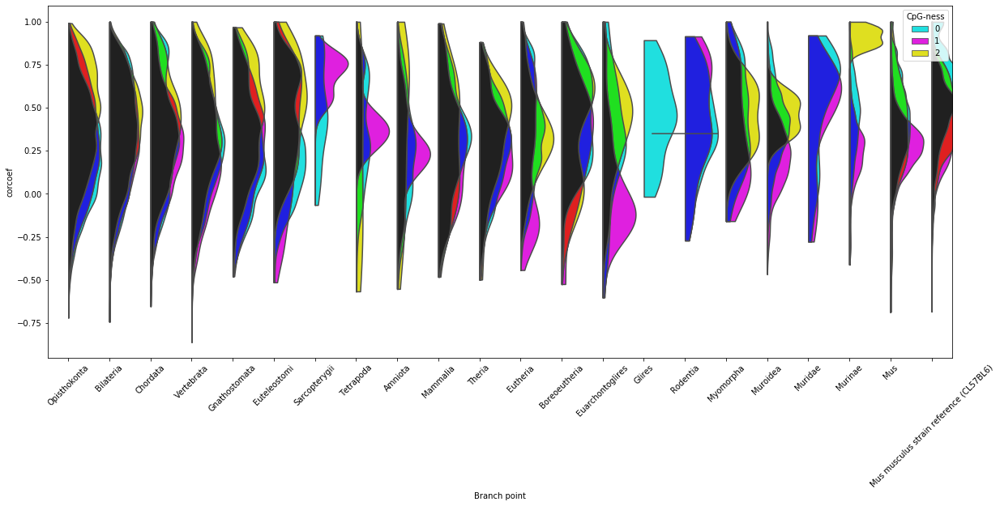

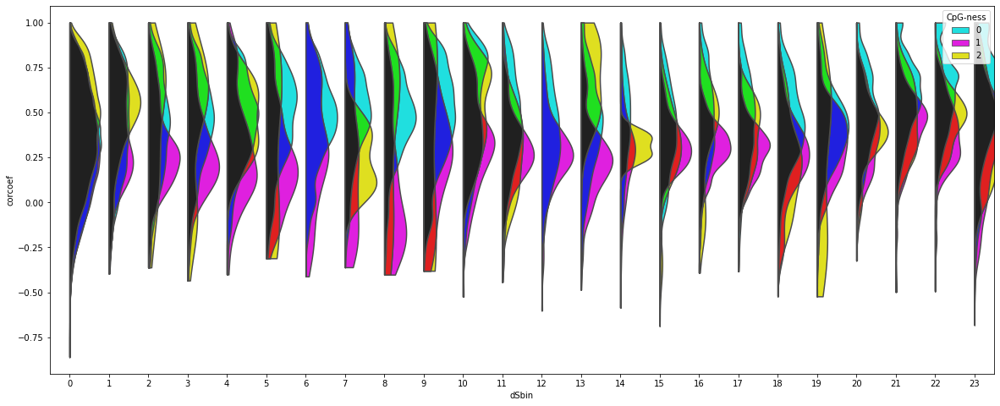

In [15]:
import scipy.stats
from seaborn import violinplot
from matplotlib import pyplot
import plots
frexpr = para.assign(expr_corr=[scipy.stats.spearmanr(genexpr.loc[g1[5:]][tissues], genexpr.loc[g2[5:]][tissues]) if g1[5:] in genexpr.index and g2[5:] in genexpr.index and len(genexpr.loc[g1[5:]][tissues])>2 and len(genexpr.loc[g2[5:]][tissues])>2 and max(genexpr.loc[g1[5:]][tissues]) > 0.5 and max(genexpr.loc[g2[5:]][tissues]) > 0.5 else None for g1,g2 in zip(para.g1, para.g2)])
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
plots.onesidedviolinplot(ax=ax, x="Branch point", y="corcoef", hue="CpG-ness", cut=0, data=frexpr.assign(corcoef=[x[0] if x != None else None for x in frexpr['expr_corr']]), inner=None, palette=['cyan', 'magenta', 'yellow'])
fig, ax = pyplot.subplots(figsize=(20,8))
plots.onesidedviolinplot(ax=ax, x="dSbin", y="corcoef",  hue="CpG-ness", cut=0, data=frexpr.assign(corcoef=[x[0] if x != None else None for x in frexpr['expr_corr']]), inner=None, palette=['cyan', 'magenta', 'yellow'])

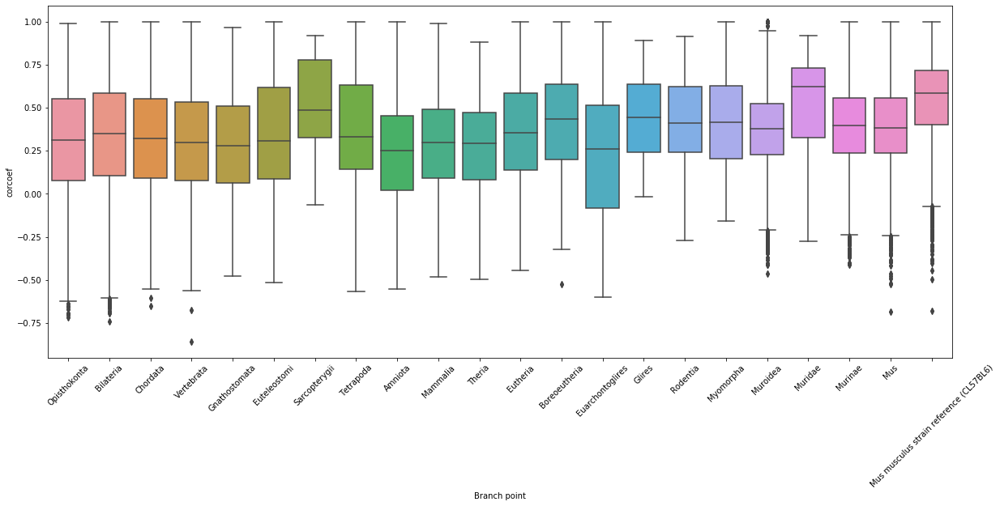

In [16]:
import seaborn
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
seaborn.boxplot(ax=ax, x="Branch point", y="corcoef", data=frexpr.assign(corcoef=[x[0] if x != None else None for x in frexpr['expr_corr']]))

In [17]:
import scipy.stats
frexpr = frexpr.assign(pearson_corr=[scipy.stats.pearsonr(genexpr.loc[g1[5:]][tissues], genexpr.loc[g2[5:]][tissues]) if g1[5:] in genexpr.index and g2[5:] in genexpr.index and len(genexpr.loc[g1[5:]][tissues])>2 and len(genexpr.loc[g2[5:]][tissues])>2 and max(genexpr.loc[g1[5:]][tissues]) > 0.5 and max(genexpr.loc[g2[5:]][tissues]) > 0.5 else None for g1,g2 in zip(para.g1, para.g2)])

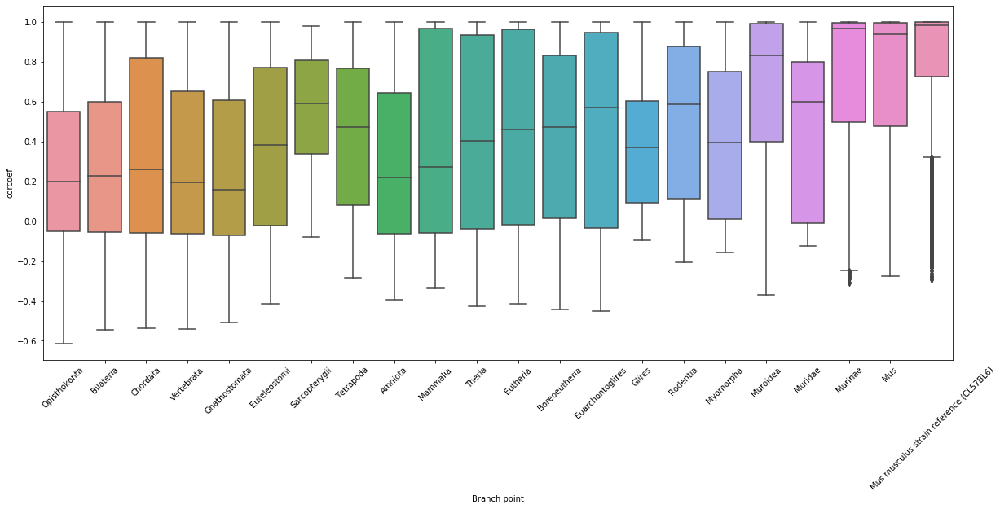

In [18]:
import seaborn
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
seaborn.boxplot(ax=ax, x="Branch point", y="corcoef", data=frexpr.assign(corcoef=[x[0] if x != None else None for x in frexpr['pearson_corr']]))

In [19]:
import numpy as np
genexptis = genexpr[tissues]
genexptis
frexpr = frexpr.assign(euclidean_corr=[np.sqrt(np.sum(np.power(genexptis.loc[g1[5:]]-genexptis.loc[g2[5:]], 2))) if g1[5:] in genexptis.index and g2[5:] in genexptis.index and (max(genexptis.loc[g1[5:]])>2 or max(genexptis.loc[g2[5:]])>2)  else None for g1,g2 in zip(para.g1, para.g2)])

Pearson's R of paralogs from Ensembl v98

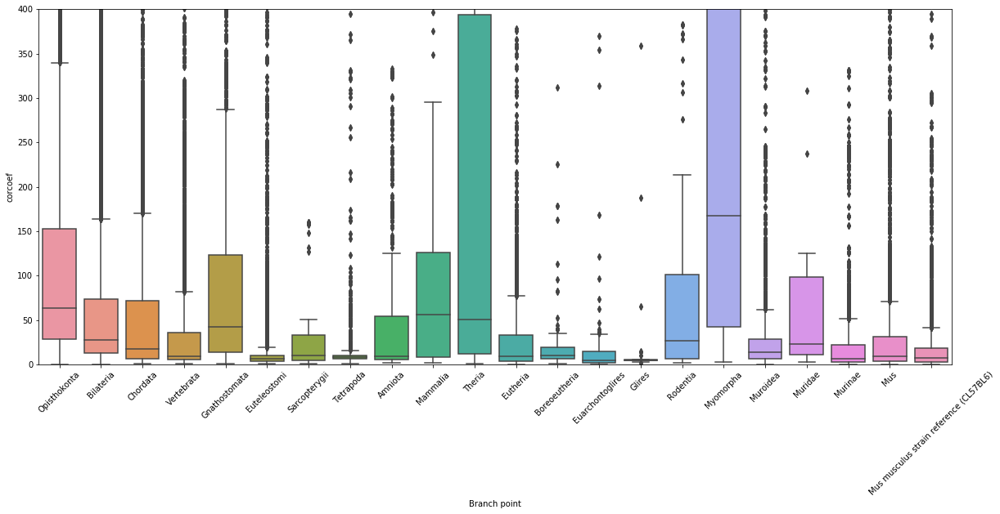

In [20]:
import seaborn
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
pyplot.ylim(0.0, 400.0)
seaborn.boxplot(ax=ax, x="Branch point", y="corcoef", data=frexpr.assign(corcoef=[x if x != None else None for x in frexpr['euclidean_corr']]))

Euclidean distance for v98 paralogs

In [21]:
para67=read_csv('./mouse_paralogs_v67.csv')
para67 = para67.assign(pearson_corr=[scipy.stats.pearsonr(genexptis.loc[g1], genexptis.loc[g2]) if g1 in genexptis.index and g2 in genexptis.index and len(genexptis.loc[g1])>2 and len(genexptis.loc[g2])>2 and (max(genexptis.loc[g1]) > 0.5 or max(genexptis.loc[g2]) > 0.5) else None for g1,g2 in zip(para67['Ensembl Gene ID'], para67['Mouse Paralog Ensembl Gene ID'])])
para67 = para67.assign(euclidean_corr=[np.sqrt(np.sum(np.power(genexptis.loc[g1]-genexptis.loc[g2], 2))) if g1 in genexptis.index and g2 in genexptis.index and len(genexptis.loc[g1])>2 and len(genexptis.loc[g2])>2 and (max(genexptis.loc[g1]) > 0.5 or max(genexptis.loc[g2]) > 0.5) else None for g1,g2 in zip(para67['Ensembl Gene ID'], para67['Mouse Paralog Ensembl Gene ID'])])

/home/gencpg/.local/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())


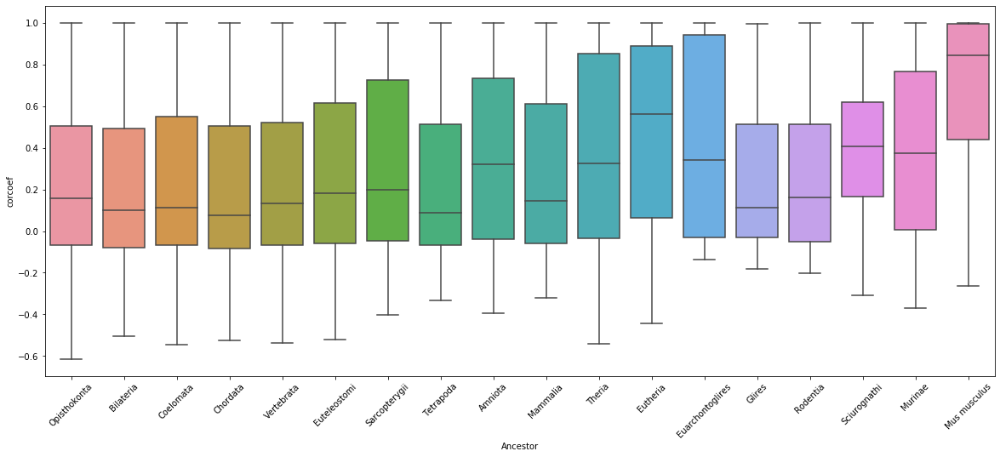

In [22]:
import seaborn
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
seaborn.boxplot(ax=ax, x="Ancestor", y="corcoef", data=para67.assign(corcoef=[x[0] if x != None else None for x in para67['pearson_corr']]), order=["Opisthokonta", "Bilateria", "Coelomata", "Chordata", "Vertebrata", "Euteleostomi", "Sarcopterygii", "Tetrapoda", "Amniota", "Mammalia", "Theria", "Eutheria", "Euarchontoglires", "Glires", "Rodentia", "Sciurognathi", "Murinae", "Mus musculus"])

Pearson's R for v67 Ensembl

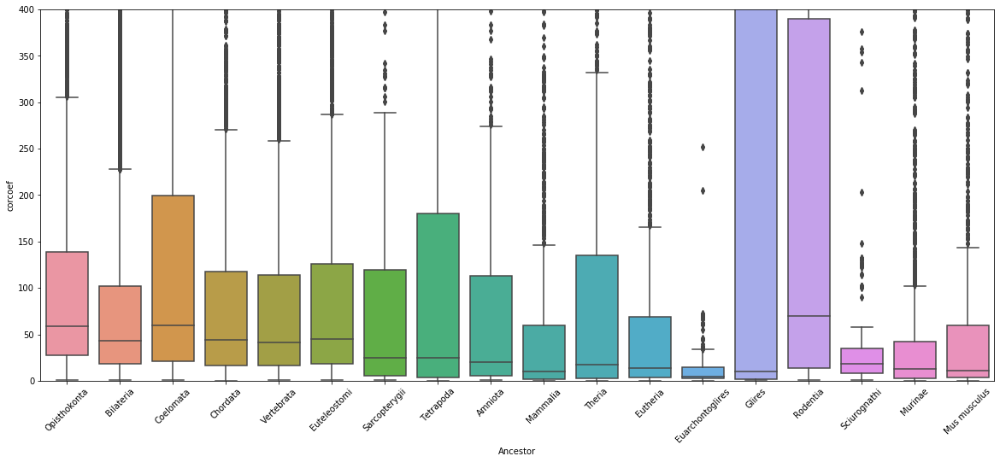

In [23]:
import seaborn
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
pyplot.ylim(0.0, 400.0)
seaborn.boxplot(ax=ax, x="Ancestor", y="corcoef", data=para67.assign(corcoef=[x if x != None else None for x in para67['euclidean_corr']]), order=["Opisthokonta", "Bilateria", "Coelomata", "Chordata", "Vertebrata", "Euteleostomi", "Sarcopterygii", "Tetrapoda", "Amniota", "Mammalia", "Theria", "Eutheria", "Euarchontoglires", "Glires", "Rodentia", "Sciurognathi", "Murinae", "Mus musculus"])

Euclidean distances for paralogs from Ensembl v67

In [24]:
frexpr=frexpr.assign(featuretype=[mouse_db[g[0]].featuretype + '-' + mouse_db[g[1]].featuretype for g in zip(frexpr.g1,frexpr.g2)])

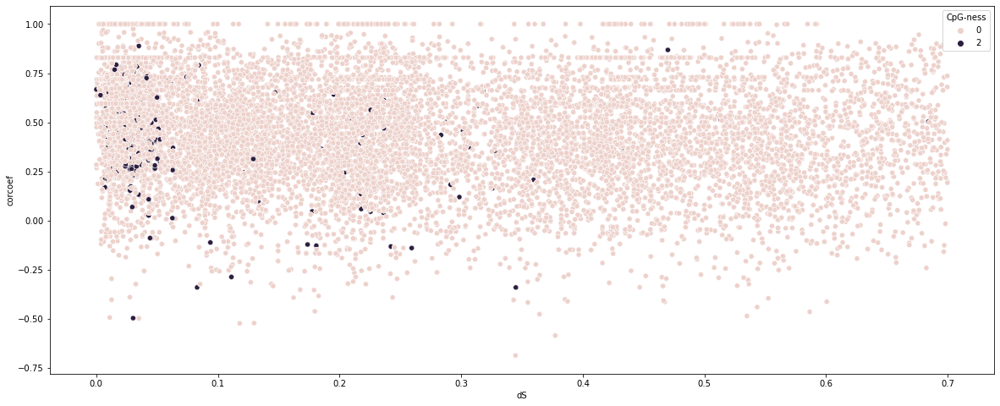

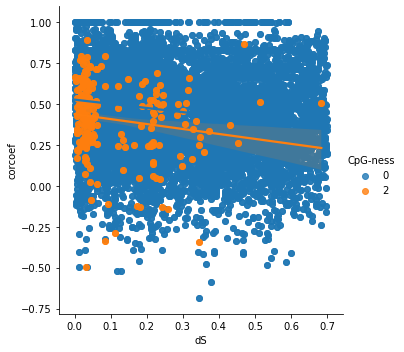

In [25]:
from seaborn import scatterplot, lmplot
from matplotlib import pyplot
import pandas as pd
fig, ax = pyplot.subplots(figsize=(20, 8))
scatterplot(ax=ax, x="dS", y="corcoef", hue="CpG-ness", data=frexpr.assign(corcoef=[x[0] if x != None else None for x in frexpr['expr_corr']])[(frexpr['dS']<=0.7) & (frexpr['dS']>0.0) & (frexpr['CpG-ness'] != 1) & (frexpr['featuretype'] == 'gene-gene') & (frexpr['dS']>0.0) & ~pd.isna(frexpr['expr_corr'])])
lmplot(x="dS", y="corcoef", hue="CpG-ness", data=frexpr.assign(corcoef=[x[0] if x != None else None for x in frexpr['expr_corr']])[(frexpr['dS']<=0.7) & (frexpr['dS']>0.0) & (frexpr['CpG-ness'] != 1) & (frexpr['featuretype'] == 'gene-gene') & (frexpr['dS']>0.0) & ~pd.isna(frexpr['expr_corr'])])

In [26]:
import numpy as np
import pandas as pd
frexpr[(frexpr['dS']<=0.7) & (frexpr['dS']>0.0) & (frexpr['CpG-ness'] != 1) & (frexpr['featuretype'] == 'gene-gene') & (frexpr['dS']>0.0) & ~pd.isna(frexpr['expr_corr'])]


,Branch point,CpG-ness,dN,dS,Similarity,Length,Distance,g1,g2,dSbin,expr_corr,pearson_corr,euclidean_corr,featuretype
1998,Opisthokonta,0,0.0053,0.1152,99.34210,12459.5,12034,gene:ENSMUSG00000020857,gene:ENSMUSG00000091228,19,"(0.04378342245989305, 0.8088309810788489)","(0.09800212138345832, 0.5874184800141126)",725.603677,gene-gene
1999,Opisthokonta,0,0.0053,0.1152,56.55430,12459.5,12034,gene:ENSMUSG00000091228,gene:ENSMUSG00000020857,19,"(0.04378342245989305, 0.8088309810788489)","(0.09800212138345832, 0.5874184800141126)",725.603677,gene-gene
2076,Opisthokonta,0,12.5467,0.1267,7.97872,32462.0,300000000,gene:ENSMUSG00000003559,gene:ENSMUSG00000093789,18,"(0.4977950728315406, 0.0032004770992328764)","(0.4786286972532289, 0.004837248424969026)",27.159384,gene-gene
2077,Opisthokonta,0,12.5467,0.1267,11.36360,32462.0,300000000,gene:ENSMUSG00000093789,gene:ENSMUSG00000003559,18,"(0.4977950728315406, 0.0032004770992328764)","(0.4786286972532289, 0.004837248424969026)",27.159384,gene-gene
5254,Opisthokonta,0,0.1092,0.4560,80.17000,13452.5,300000000,gene:ENSMUSG00000050195,gene:ENSMUSG00000037071,14,"(-0.06283422459893048, 0.7283052128479877)","(-0.17276700081213112, 0.33632156273999125)",1436.377402,gene-gene
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
713131,Mus musculus strain reference (CL57BL6),0,0.0158,0.0633,96.86880,161981.0,542223,gene:ENSMUSG00000101337,gene:ENSMUSG00000041144,20,"(0.7561467771933429, 3.597113801981017e-07)","(0.99727090700117, 1.172005154541842e-36)",5.159214,gene-gene
713132,Mus musculus strain reference (CL57BL6),0,0.0175,0.0726,95.37860,308283.5,300000000,gene:ENSMUSG00000041144,gene:ENSMUSG00000096141,20,"(0.41376892368630147, 0.01668136776481579)","(0.9953786177246617, 4.0644656941369895e-33)",11.559148,gene-gene
713133,Mus musculus strain reference (CL57BL6),0,0.0175,0.0726,96.42150,308283.5,300000000,gene:ENSMUSG00000096141,gene:ENSMUSG00000041144,20,"(0.41376892368630147, 0.01668136776481579)","(0.9953786177246617, 4.0644656941369895e-33)",11.559148,gene-gene
713134,Mus musculus strain reference (CL57BL6),0,0.0191,0.0697,96.24750,163452.5,300000000,gene:ENSMUSG00000101337,gene:ENSMUSG00000096141,20,"(0.6033378420736756, 0.00020181209221637882)","(0.9971881053654391, 1.8615953155601113e-36)",6.569057,gene-gene


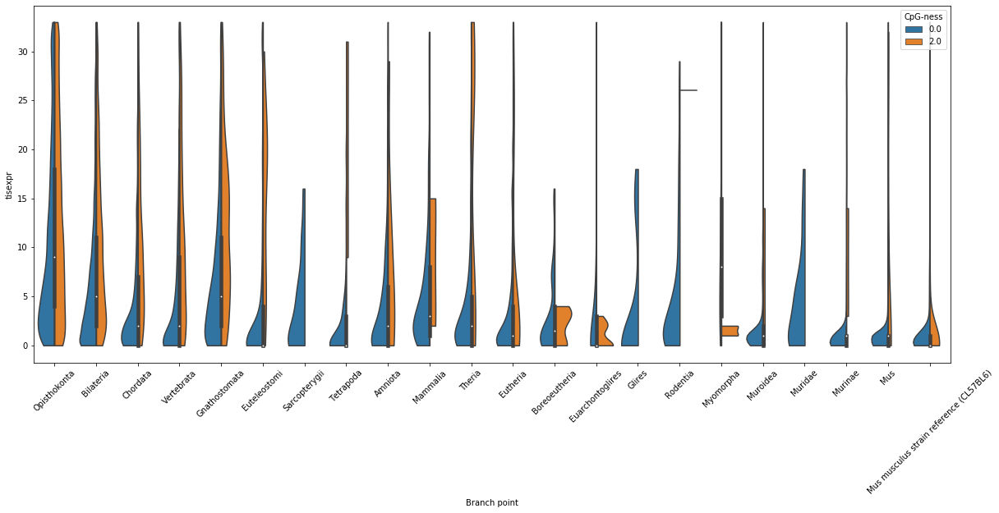

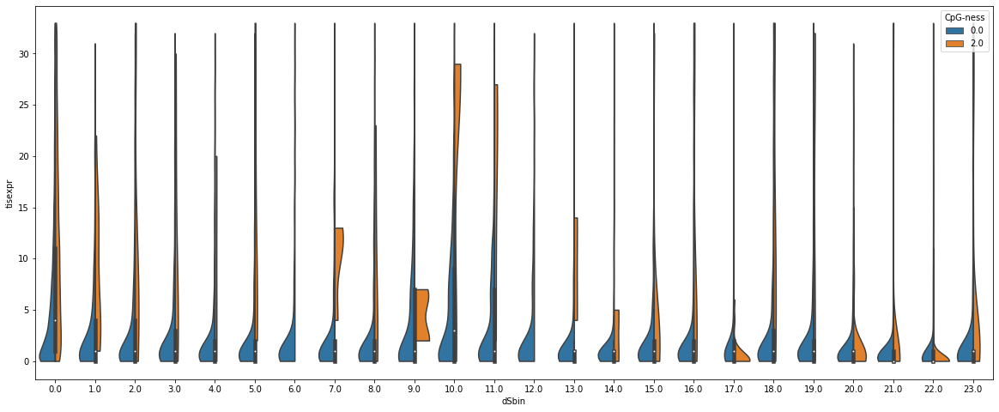

In [27]:
import scipy.stats
from seaborn import violinplot

tisexpr = para.assign(tisexpr=[sum((genexpr.loc[g1[5:]][tissues]<5) ^ (genexpr.loc[g2[5:]][tissues]<5)) if g1[5:] in genexpr.index and g2[5:] in genexpr.index and len(genexpr.loc[g1[5:]][tissues])>2 and len(genexpr.loc[g2[5:]][tissues])>2  and max(genexpr.loc[g1[5:]][tissues]) > 0.5 and max(genexpr.loc[g2[5:]][tissues]) > 0.5 else None for g1,g2 in para[['g1', 'g2']].iloc])
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
violinplot(ax=ax, x="Branch point", y="tisexpr", hue="CpG-ness", cut=0, data=tisexpr.where(para["CpG-ness"] != 1), split=True)
pyplot.show()
fig, ax = pyplot.subplots(figsize=(20, 8))
violinplot(ax=ax, x="dSbin", y="tisexpr", hue="CpG-ness", cut=0, data=tisexpr.where(para["CpG-ness"] != 1), split=True)
pyplot.show()

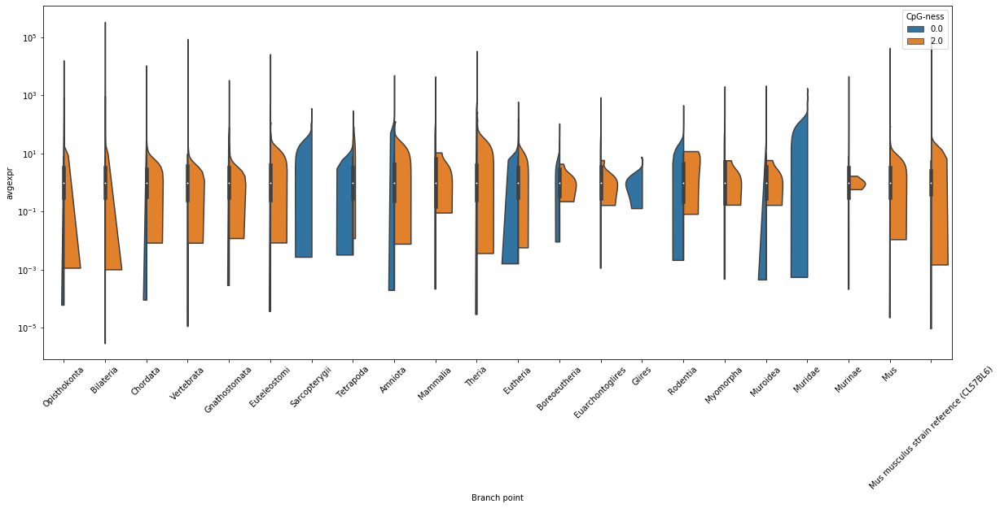

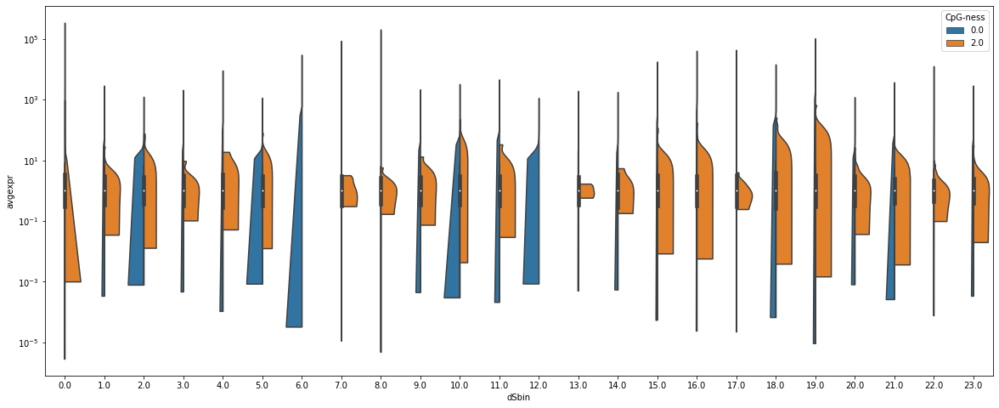

In [28]:
from seaborn import violinplot
import numpy as np

avgexpr = para.assign(avgexpr=[genexpr.loc[g1[5:]][tissues].mean()/genexpr.loc[g2[5:]][tissues].mean() if g1[5:] in genexpr.index and g2[5:] in genexpr.index and len(genexpr.loc[g1[5:]][tissues])>2 and len(genexpr.loc[g2[5:]][tissues])>2  and max(genexpr.loc[g1[5:]][tissues]) > 0.5 and max(genexpr.loc[g2[5:]][tissues]) > 0.5 else None for g1,g2 in para[['g1', 'g2']].iloc])
avgexpr = avgexpr.replace([np.inf], np.power(10.,10)).replace([-np.inf],np.power(10.,-10)).dropna()
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=45)
pyplot.yscale('log')
violinplot(ax=ax, x="Branch point", y="avgexpr", hue="CpG-ness", cut=0, data=avgexpr.where(para["CpG-ness"] != 1), split=True)
pyplot.show()
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.yscale('log')
violinplot(ax=ax, x="dSbin", y="avgexpr", hue="CpG-ness", cut=0, data=avgexpr.where(para["CpG-ness"] != 1), split=True)
pyplot.show()

In [29]:
epipot = [l.strip() for l in open('/home/evgeny/tau/gen_cpg/epi_potential_genes.txt', 'r').readlines()]
print('%d, %d:%d, %d:%d'%(len(epipot), len([e for e in epipot if 'gene:'+e in cpg_less]), len([e for e in epipot if 'gene:'+e in cpg_full]), len(cpg_less), len(cpg_full)))

1930, 1115:806, 14830:6955


21874
Median CPG full:less : 1449.000000:183.500000
Average CPG full:less : 1331.266858:512.734390


/home/gencpg/.local/lib/python3.8/site-packages/numpy/lib/function_base.py:495: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/gencpg/.local/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_7713/989621039.py:44: RuntimeWarning: invalid value encountered in double_scalars
  fact_diff_frames[pre_tss] = DataFrame.from_records([(p[0], p[1], p[2], (p[1] in cpg_full)+(p[2] in cpg_full), abs(factors[:,genemap[p[1]]].sum()-factors[:,genemap[p[2]]].sum()), abs(np.log(factors[:,genemap[p[1]]].sum()+1)-np.log(factors[:,genemap[p[2]]].sum()+1)), (factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum(), (100.0*factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum()/(factors[:,genemap[p[1]]]|factors[:,genemap[p[2]]]).sum(), factors[:, genemap[p[1]]].sum(), factors[:, genemap[p[2]]].sum()) for p in itertools.chain(*[[(k,) + w for w in v] for k, v in paralogs.items(

21874
Median CPG full:less : 1524.000000:218.000000
Average CPG full:less : 1395.611071:545.651450


/home/gencpg/.local/lib/python3.8/site-packages/numpy/lib/function_base.py:495: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/gencpg/.local/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_7713/989621039.py:44: RuntimeWarning: invalid value encountered in double_scalars
  fact_diff_frames[pre_tss] = DataFrame.from_records([(p[0], p[1], p[2], (p[1] in cpg_full)+(p[2] in cpg_full), abs(factors[:,genemap[p[1]]].sum()-factors[:,genemap[p[2]]].sum()), abs(np.log(factors[:,genemap[p[1]]].sum()+1)-np.log(factors[:,genemap[p[2]]].sum()+1)), (factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum(), (100.0*factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum()/(factors[:,genemap[p[1]]]|factors[:,genemap[p[2]]]).sum(), factors[:, genemap[p[1]]].sum(), factors[:, genemap[p[2]]].sum()) for p in itertools.chain(*[[(k,) + w for w in v] for k, v in paralogs.items(

21874
Median CPG full:less : 1583.000000:279.000000
Average CPG full:less : 1453.638246:593.794471


/home/gencpg/.local/lib/python3.8/site-packages/numpy/lib/function_base.py:495: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/gencpg/.local/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_7713/989621039.py:44: RuntimeWarning: invalid value encountered in double_scalars
  fact_diff_frames[pre_tss] = DataFrame.from_records([(p[0], p[1], p[2], (p[1] in cpg_full)+(p[2] in cpg_full), abs(factors[:,genemap[p[1]]].sum()-factors[:,genemap[p[2]]].sum()), abs(np.log(factors[:,genemap[p[1]]].sum()+1)-np.log(factors[:,genemap[p[2]]].sum()+1)), (factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum(), (100.0*factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum()/(factors[:,genemap[p[1]]]|factors[:,genemap[p[2]]]).sum(), factors[:, genemap[p[1]]].sum(), factors[:, genemap[p[2]]].sum()) for p in itertools.chain(*[[(k,) + w for w in v] for k, v in paralogs.items(

21874
Median CPG full:less : 1376.000000:169.000000
Average CPG full:less : 1270.801869:494.047539


/home/gencpg/.local/lib/python3.8/site-packages/numpy/lib/function_base.py:495: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/gencpg/.local/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_7713/989621039.py:44: RuntimeWarning: invalid value encountered in double_scalars
  fact_diff_frames[pre_tss] = DataFrame.from_records([(p[0], p[1], p[2], (p[1] in cpg_full)+(p[2] in cpg_full), abs(factors[:,genemap[p[1]]].sum()-factors[:,genemap[p[2]]].sum()), abs(np.log(factors[:,genemap[p[1]]].sum()+1)-np.log(factors[:,genemap[p[2]]].sum()+1)), (factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum(), (100.0*factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum()/(factors[:,genemap[p[1]]]|factors[:,genemap[p[2]]]).sum(), factors[:, genemap[p[1]]].sum(), factors[:, genemap[p[2]]].sum()) for p in itertools.chain(*[[(k,) + w for w in v] for k, v in paralogs.items(

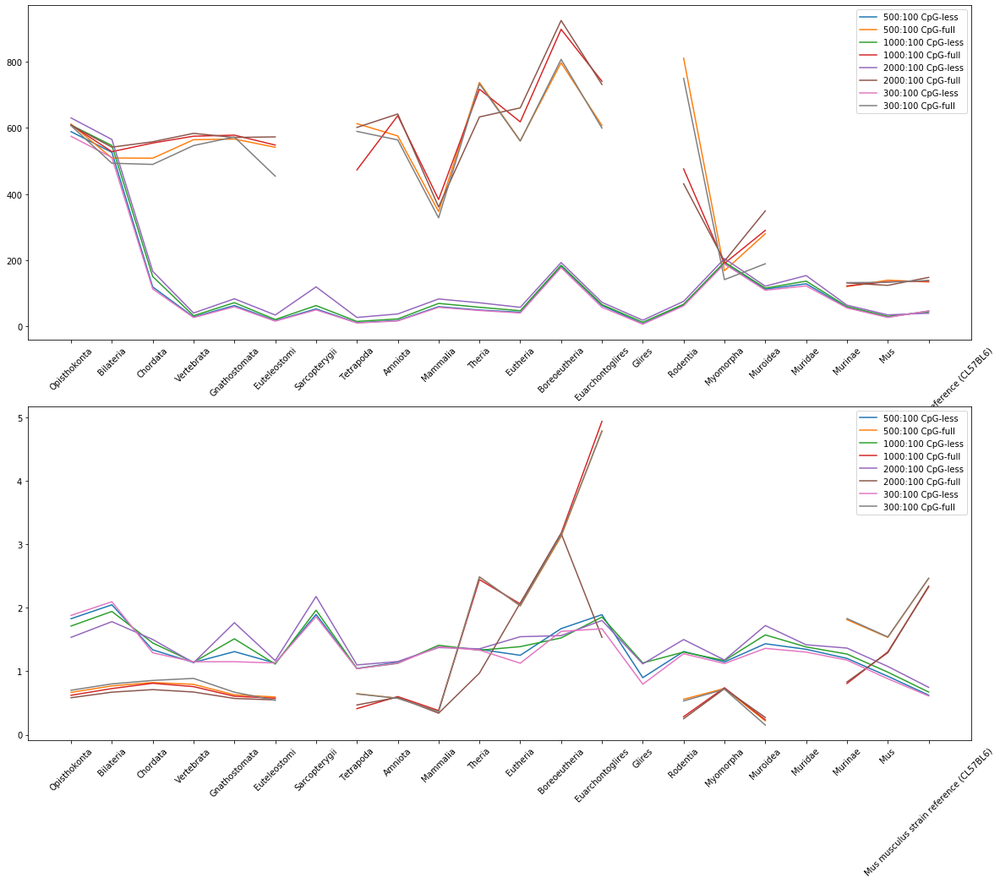

In [30]:
from pybedtools import *
import overlap_calc
import re
import itertools
from csv import DictReader
from matplotlib.pyplot import show
factNum=sum((1 for prom in DictReader(open('/data/db/import/mouse_factor_full_QC.txt', 'r'), delimiter='\t') if not re.fullmatch("CTCF|RAD21|REST|EP300|.*POLR.*", prom['Factor'])))
fig, (ax1,ax2) = pyplot.subplots(2,1,figsize=(20,16))
ax1.tick_params('x', labelrotation=45)
ax2.tick_params('x', labelrotation=45)
fact_diff_frames = {}
for pre_tss in [500, 1000, 2000, 300]:
    gene_prom_area=overlap_calc.canon_ints(canons.values(),pre_tss=pre_tss, post_tss=100)
    factors = np.zeros((factNum, len(canons)), dtype='int8')
    genemap = dict([(gene_prom_area[i].name, i) for i in range(0, len(gene_prom_area))])
    fact=-1
    print(len(canons))
    DCids = []
    for prom in DictReader(open('/data/db/import/mouse_factor_full_QC.txt', 'r'), delimiter='\t'):
        if re.fullmatch("CTCF|RAD21|REST|EP300|.*POLR.*", prom['Factor']):
            #print('Skipping %s'%prom['Factor'])
            continue
        fact += 1
        DCids.append(int(prom['DCid']))
        factors[fact,[genemap[x.name] for x in BedTool(gene_prom_area).intersect(BedTool('/data/db/import/mouse_factor/'+prom['DCid']+'_sort_peaks.narrowPeak.bed'))]] += 1
    print('Median CPG full:less : %f:%f'%(np.median(factors[:,[genemap[x] for x in cpg_full]].sum(axis=0)),
                                      np.median(factors[:,[genemap[x] for x in cpg_less]].sum(axis=0))))
    print('Average CPG full:less : %f:%f'%(np.average(factors[:,[genemap[x] for x in cpg_full]].sum(axis=0)),
                                      np.average(factors[:,[genemap[x] for x in cpg_less]].sum(axis=0))))
    fact_diff = {}
    for b in paralogs.keys():
        l = [x for x in paralogs[b] if x[0] in cpg_less and x[1] in cpg_less]
        f = [x for x in paralogs[b] if x[0] in cpg_full and x[1] in cpg_full]
        fact_diff[b] = (
            np.average([abs(factors[:,genemap[p[0]]].sum()-factors[:,genemap[p[1]]].sum()) for p in l]),
            np.average([abs(factors[:,genemap[p[0]]].sum()-factors[:,genemap[p[1]]].sum()) for p in f]),
            np.average([abs(np.log(factors[:,genemap[p[0]]].sum()+1)-np.log(factors[:,genemap[p[1]]].sum()+1)) for p in l]),
            np.average([abs(np.log(factors[:,genemap[p[0]]].sum()+1)-np.log(factors[:,genemap[p[1]]].sum()+1)) for p in f]),
        )
    ax1.plot(branch_order, [fact_diff[b][0] for b in branch_order], label='%d:100 CpG-less'%(pre_tss))
    ax1.plot(branch_order, [fact_diff[b][1] for b in branch_order], label='%d:100 CpG-full'%(pre_tss))
    ax2.plot(branch_order, [fact_diff[b][2] for b in branch_order], label='%d:100 CpG-less'%(pre_tss))
    ax2.plot(branch_order, [fact_diff[b][3] for b in branch_order], label='%d:100 CpG-full'%(pre_tss))
    fact_diff_frames[pre_tss] = DataFrame.from_records([(p[0], p[1], p[2], (p[1] in cpg_full)+(p[2] in cpg_full), abs(factors[:,genemap[p[1]]].sum()-factors[:,genemap[p[2]]].sum()), abs(np.log(factors[:,genemap[p[1]]].sum()+1)-np.log(factors[:,genemap[p[2]]].sum()+1)), (factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum(), (100.0*factors[:,genemap[p[1]]]*factors[:,genemap[p[2]]]).sum()/(factors[:,genemap[p[1]]]|factors[:,genemap[p[2]]]).sum(), factors[:, genemap[p[1]]].sum(), factors[:, genemap[p[2]]].sum()) for p in itertools.chain(*[[(k,) + w for w in v] for k, v in paralogs.items()])], columns=['Branch point', 'g1', 'g2', 'CpG-ness', 'change', 'fold', 'mutual', 'mut-pct', 'factors-g1', 'factors-g2'])

ax1.set_label('Expressed factors mean difference per branch-point')
ax2.set_label('log(Expressed factors) mean difference per branch-point')

ax1.legend()
ax2.legend()
pyplot.show()
fact_diff_frame=fact_diff_frames[300]


In [35]:
fact_diff_frame=fact_diff_frame.join(para.set_index(['g1', 'g2'])['dSbin'], on=['g1', 'g2'])
fact_diff_frame

ValueError: columns overlap but no suffix specified: Index(['dSbin'], dtype='object')

In [31]:
import random
tfbm_scores = [(factors[:,genemap[x]]*factors[:,genemap[y]]).sum() for x,y in zip(random.sample(list(canons.keys()), 10000), random.sample(list(canons.keys()), 10000)) if factors[:,genemap[x]].sum() >= 2 or factors[:,genemap[y]].sum() >= 2]
tfbm_scores_pct = [(factors[:,genemap[x]]*factors[:,genemap[y]]).sum()/(factors[:,genemap[x]]|factors[:,genemap[y]]).sum() for x,y in zip(random.sample(list(canons.keys()), 10000), random.sample(list(canons.keys()), 10000)) if factors[:,genemap[x]].sum() >= 2 or factors[:,genemap[y]].sum() >= 2]

In [34]:
#fact_diff_frames[300].
list(para.columns)

['Branch point',
 'CpG-ness',
 'dN',
 'dS',
 'Similarity',
 'Length',
 'Distance',
 'g1',
 'g2',
 'dSbin']

In [ ]:
from seaborn import violinplot, despine
fig, ax = pyplot.subplots(figsize=(15,8))
pyplot.xticks(rotation=45)
violinplot(ax=ax, x="Branch point", y="change", hue="CpG-ness", cut=0, data=fact_diff_frame[fact_diff_frame["CpG-ness"]!=1], order=branch_order, split=True)
despine()
fig, ax = pyplot.subplots(figsize=(15,8))
violinplot(ax=ax, x="dSbin", y="change", hue="CpG-ness", cut=0, data=fact_diff_frame[fact_diff_frame["CpG-ness"]!=1], split=True)
despine()

In [ ]:
fig, ax = pyplot.subplots(figsize=(15,8))
pyplot.xticks(rotation=45)
violinplot(ax=ax, x="Branch point", y="fold", hue="CpG-ness", cut=0, data=fact_diff_frame[fact_diff_frame["CpG-ness"]!=1], order=branch_order, split=True)
despine()
fig, ax = pyplot.subplots(figsize=(15,8))
violinplot(ax=ax, x="dSbin", y="fold", hue="CpG-ness", cut=0, data=fact_diff_frame[fact_diff_frame["CpG-ness"]!=1], split=True)
despine()

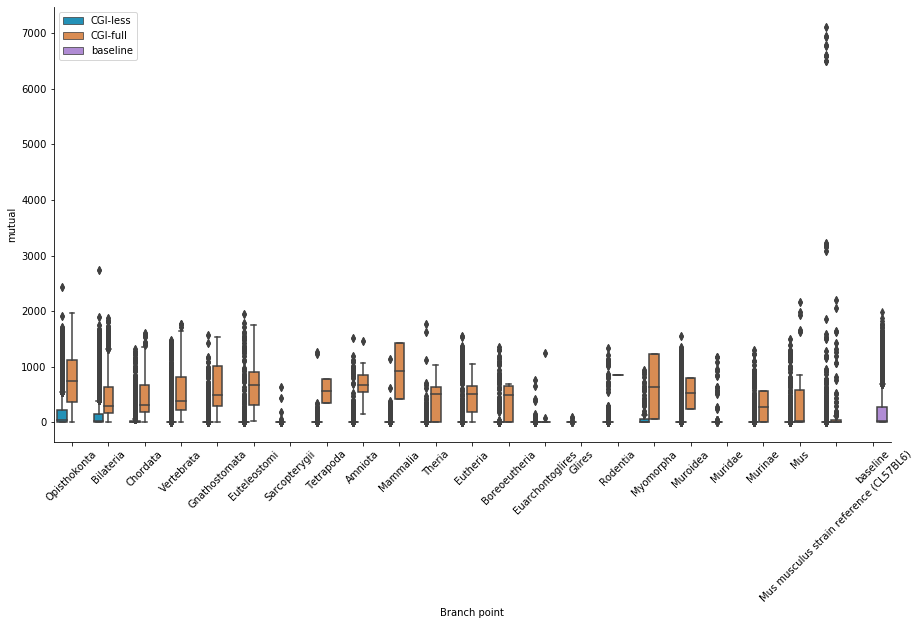

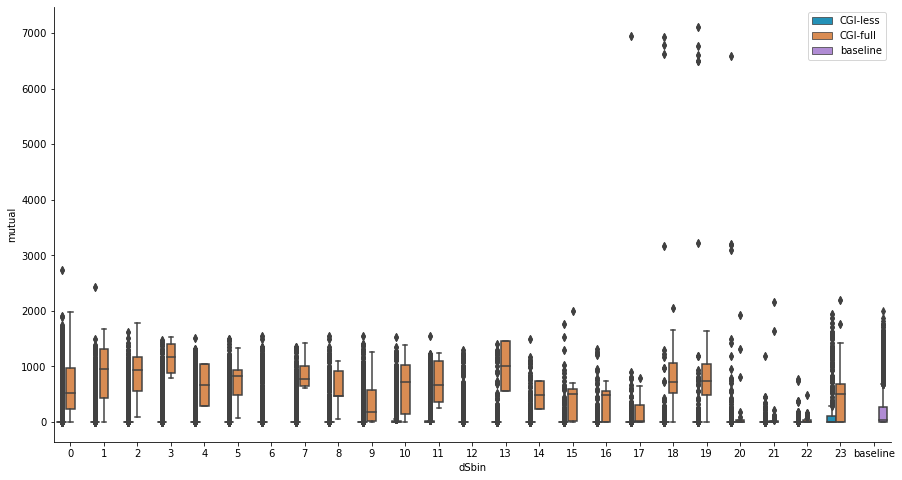

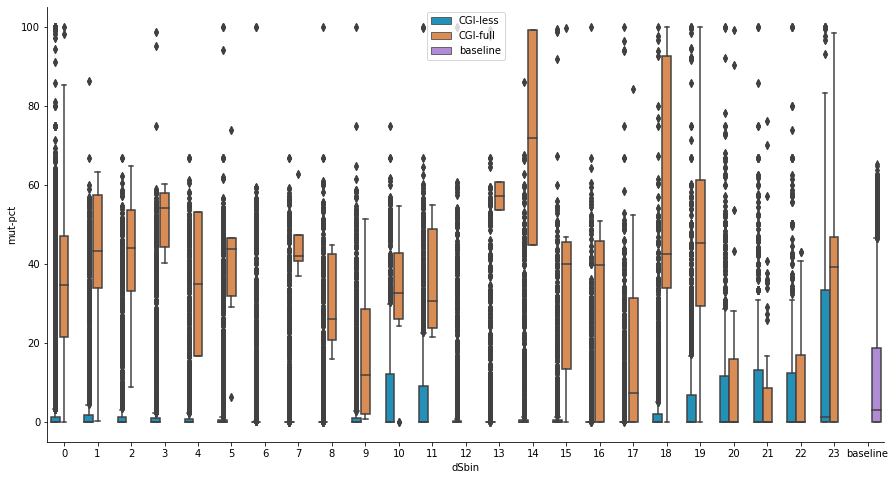

In [57]:
from seaborn import boxplot, despine
import matplotlib.pyplot as plt
fig, ax = pyplot.subplots(figsize=(15,8))
pyplot.xticks(rotation=45)
g=boxplot(ax=ax, x="Branch point", y="mutual", hue="CpG-ness", data=pd.concat([fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))], pd.DataFrame.from_dict({'mutual':tfbm_scores}).assign(**{'CpG-ness':3, 'Branch point':'baseline'})]), order=[*branch_order, 'baseline'], palette=['#0b9dcf', '#ef893d', '#b080e0'], dodge=True)
handles, _ = g.get_legend_handles_labels()
g.legend(handles, ['CGI-less', 'CGI-full', 'baseline'])
despine()
plt.savefig('mouse-tfbm-mutual-by-cgi-bp-with-baseline.pdf', dpi=600)
fig, ax = pyplot.subplots(figsize=(15,8))
g=boxplot(ax=ax, x="dSbin", y="mutual", hue="CpG-ness", data=pd.concat([fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))], pd.DataFrame.from_dict({'mutual':tfbm_scores}).assign(**{'CpG-ness':3, 'dSbin': 'baseline'})]), order=[*sorted(fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['dSbin'].unique()), 'baseline'], palette=['#0b9dcf', '#ef893d', '#b080e0'], dodge=True)
handles, _ = g.get_legend_handles_labels()
g.legend(handles, ['CGI-less', 'CGI-full', 'baseline'])
despine()
plt.savefig('mouse-tfbm-mutual-by-cgi-ds-with-baseline.pdf', dpi=600)
fig, ax = pyplot.subplots(figsize=(15,8))
g=boxplot(ax=ax, x="dSbin", y="mut-pct", hue="CpG-ness", data=pd.concat([fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))], pd.DataFrame.from_dict({'mut-pct':[x*100 for x in tfbm_scores_pct]}).assign(**{'CpG-ness':3, 'dSbin': 'baseline'})]), order=[*sorted(fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['dSbin'].unique()), 'baseline'], palette=['#0b9dcf', '#ef893d', '#b080e0'], dodge=True)
handles, _ = g.get_legend_handles_labels()
g.legend(handles, ['CGI-less', 'CGI-full', 'baseline'])
despine()
plt.savefig('mouse-tfbm-mutpct-by-cgi-ds-with-baseline.pdf', dpi=600)

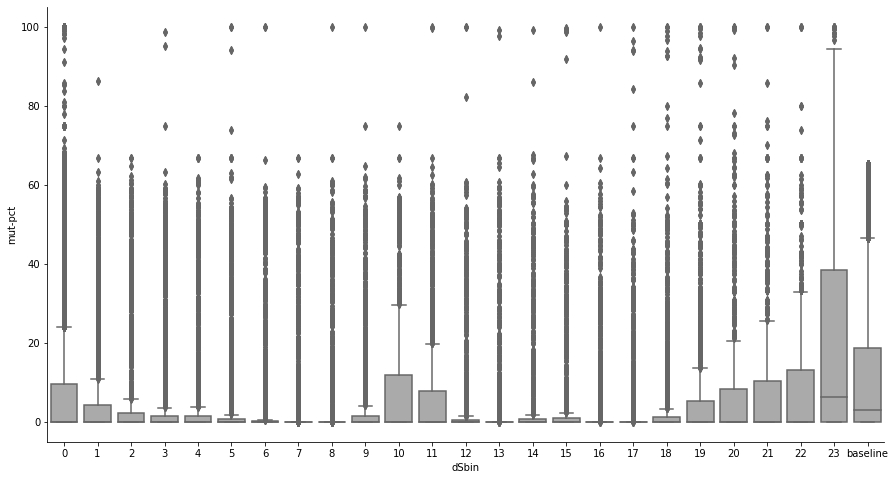

In [63]:
fig, ax = pyplot.subplots(figsize=(15,8))
g=boxplot(ax=ax, x="dSbin", y="mut-pct", data=pd.concat([fact_diff_frame[((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))], pd.DataFrame.from_dict({'mut-pct':[x*100 for x in tfbm_scores_pct*100]}).assign(**{'dSbin': 'baseline'})]), order=[*sorted(fact_diff_frame[((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['dSbin'].unique()), 'baseline'], palette=['#aaaaaa'], dodge=True)
despine()
plt.savefig('mouse-tfbm-mutpct-ds-with-baseline.pdf', dpi=600)

In [62]:
from scipy.stats import mannwhitneyu
for x in sorted(fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['dSbin'].unique()):
    if sum((fact_diff_frame['dSbin'] == x)&(fact_diff_frame['CpG-ness'] == 0)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))) > 0 and sum((fact_diff_frame['dSbin'] == x)&(fact_diff_frame['CpG-ness'] == 2)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))) > 0:
        print("Mann-Whitney test on TFBM dSbin %d CGI-full vs. CGI-less, FDR controlled: %s"%(x, mannwhitneyu(fact_diff_frame[(fact_diff_frame['dSbin'] == x)&(fact_diff_frame['CpG-ness'] == 2)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['mut-pct'], fact_diff_frame[(fact_diff_frame['dSbin'] == x)&(fact_diff_frame['CpG-ness'] == 0)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['mut-pct'], alternative='greater').pvalue*len(fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['dSbin'].unique())))
        print("Mann-Whitney test on TFBM dSbin %d CGI-full vs. baseline, FDR controlled: %s"%(x, mannwhitneyu(fact_diff_frame[(fact_diff_frame['dSbin'] == x)&(fact_diff_frame['CpG-ness'] == 2)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['mut-pct'], [x*100 for x in tfbm_scores_pct], alternative='greater').pvalue*len(fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['dSbin'].unique())))
        print("Mann-Whitney test on TFBM dSbin %d CGI-less vs. baseline, FDR controlled: %s"%(x, mannwhitneyu(fact_diff_frame[(fact_diff_frame['dSbin'] == x)&(fact_diff_frame['CpG-ness'] == 0)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['mut-pct'], [x*100 for x in tfbm_scores_pct], alternative='less').pvalue*len(fact_diff_frame[(fact_diff_frame['CpG-ness'] != 1)&((fact_diff_frame['factors-g1'] >= 2) | (fact_diff_frame['factors-g2'] >= 2))]['dSbin'].unique())))


Mann-Whitney test on TFBM dSbin 0 CGI-full vs. CGI-less, FDR controlled: 0.0
Mann-Whitney test on TFBM dSbin 0 CGI-full vs. baseline, FDR controlled: 0.0
Mann-Whitney test on TFBM dSbin 0 CGI-less vs. baseline, FDR controlled: 0.0
Mann-Whitney test on TFBM dSbin 1 CGI-full vs. CGI-less, FDR controlled: 8.33313580709212e-19
Mann-Whitney test on TFBM dSbin 1 CGI-full vs. baseline, FDR controlled: 1.8838380224238124e-08
Mann-Whitney test on TFBM dSbin 1 CGI-less vs. baseline, FDR controlled: 1.822411319354387e-288
Mann-Whitney test on TFBM dSbin 2 CGI-full vs. CGI-less, FDR controlled: 3.9807189045781e-19
Mann-Whitney test on TFBM dSbin 2 CGI-full vs. baseline, FDR controlled: 2.350885174055156e-10
Mann-Whitney test on TFBM dSbin 2 CGI-less vs. baseline, FDR controlled: 8.755204688032177e-290
Mann-Whitney test on TFBM dSbin 3 CGI-full vs. CGI-less, FDR controlled: 4.9053453605329594e-14
Mann-Whitney test on TFBM dSbin 3 CGI-full vs. baseline, FDR controlled: 2.569804993075953e-08
Mann-Whi

In [ ]:
from seaborn import boxplot
from math import ceil, log
fig, ax = pyplot.subplots(figsize=(15,8))
pyplot.xticks(rotation=45)
boxplot(ax=ax, x="Branch point", y="mut-pct", hue="CpG-ness", data=fact_diff_frame, order=branch_order)
despine()
fig, ax = pyplot.subplots(figsize=(15,8))
boxplot(ax=ax, x="dSbin", y="mut-pct", hue="CpG-ness", data=fact_diff_frame)
despine()

In [ ]:
from pandas import Series
from math import log
genentropy = genexpr.drop(columns=['cpgness', 'cpgfull'])
genentropy.index = [g.split('.')[0] for g in genentropy.index]
genentropy=genentropy.apply(lambda x : Series([i/x.sum() for i in x]) if x.sum()>1e-10 else Series([0 for i in x]), axis=1)
genentropy=genentropy.apply(lambda x : sum((-i*log(i+1e-10)/log(2) for i in x)), axis=1)


In [ ]:
from math import log,exp
def exp_diff(x,y):
    RANGE=20
    if x<y:
        return -exp_diff(y,x)
    if x<1:
        return 0
    elif x>2 and y>x/exp(RANGE):
        return min(RANGE, log(x/y))
    elif x>2 and y<=x/exp(RANGE):
        return RANGE
    elif y>x/exp(RANGE):
        return log(x/y)*(x-1)
    else:
        return RANGE*(x-1)
    


In [40]:
can_fr=DataFrame.from_records([((k,)+v) for k,v in canons.items()], columns=['gene', 'feature', 'seq', 'first_intron', 'introns']).set_index('gene')
def coldec(postfix):
    return lambda c: c.replace('(','-').replace(')','-')+'-'+postfix
export=frexpr.assign(expr_corr_factor=lambda x: [v[0] if v is not None else None for v in x.expr_corr]).assign(expr_corr_pval=lambda x: [v[1] if v is not None else None for v in x.expr_corr]).drop(columns=['expr_corr']).\
             join(can_fr[['first_intron', 'introns']].rename(columns=coldec('g1')), on='g1').\
             join(can_fr[['first_intron', 'introns']].rename(columns=coldec('g2')), on='g2').\
             join(fact_diff_frame[['g1', 'g2', 'change','fold','mutual','mut-pct','factors-g1','factors-g2']].set_index(['g1', 'g2']), on=['g1', 'g2'])
for pre_tss in [500, 1000, 2000]:
    export=export.join(fact_diff_frames[pre_tss][['g1', 'g2', 'change','fold','mutual','mut-pct','factors-g1','factors-g2']].set_index(['g1', 'g2']).rename(columns=coldec('%d'%pre_tss)), on=['g1', 'g2'])
export = export.assign(g1=lambda x: [v[5:] for v in x.g1]).join(genexpr.drop(columns=['cpgness', 'cpgfull']).rename(columns=coldec('g1-tpm')), on='g1').\
             assign(g2=lambda x: [v[5:] for v in x.g2]).join(genexpr.drop(columns=['cpgness', 'cpgfull']).rename(columns=coldec('g2-tpm')), on='g2')
for prom in [ "mouse_overlaps_ensembl_300", "mouse_overlaps_ensembl_500", "mouse_overlaps_ensembl_1000", "mouse_overlaps_ensembl_2000", "mouse_overlaps_liver_300", "mouse_overlaps_liver_500", "mouse_overlaps_liver_1000", "mouse_overlaps_liver_2000", "mm_elife_overlaps"]:
    ovl = pickle.load(open('%s.pkl'%(prom,), 'rb'))
    export = export.assign(**{prom : lambda x: [(1 if ovl['gene:'+x[0]] > 0.5 else 0) + (1 if ovl['gene:'+x[1]] > 0.5 else 0)  if 'gene:'+x[0] in ovl and 'gene:'+x[1] in ovl else None for x in zip(x.g1, x.g2)]})
export = export.join(genentropy.rename('Entropy-g1'), on='g1').join(genentropy.rename('Entropy-g2'), on='g2')

from math import isnan
export = export.assign(**{'-'.join(t.split('-')[:-1])+'-mean-log-diff': Series([
    (exp_diff(g1,g2))  if (not isnan(g1) and not isnan(g2)) else None for g1,g2 in zip(export['g1'].map(mean_tpm[t]), export['g2'].map(mean_tpm[t]))
]) for t in mean_tpm.columns})

diffcols = [c for c in export.columns if c.endswith('-mean-log-diff')]
export = export.assign(mx=export[diffcols].max(axis=1), mn=-export[diffcols].min(axis=1), mxidx=export[diffcols].idxmax(axis=1), mnidx=export[diffcols].idxmin(axis=1))
export = export.assign(NEO2=lambda x : (x['expr_corr_factor']<0.11) & (x['Entropy-g1']<3.854) & (x['Entropy-g2']<3.854))
export = export.join(pickle.load(open('/data/db/import/save/mouse-export-sim-local.pkl', 'rb'))[['g1','g2','PromPresScore300','PromPresTssMinus300','PromPresShift300']].set_index(['g1', 'g2']), on=['g1', 'g2'])
export = export.assign(g1_cpgness=('gene:'+export['g1']).isin(cpg_full)).assign(g2_cpgness=('gene:'+export['g2']).isin(cpg_full))
export[export['g1']<export['g2']].to_csv('mouse-paralogs.csv')

In [ ]:
import homologs
from homologs import ortholog_count_by_gene
fam_pvalues = {'gene:'+v.split()[0]:float(v.split()[1]) for v in open('mouse-genes-p-value.txt').readlines()}
exp_genes = can_fr.assign(transcript_length=lambda x: [len(v) for v in x.seq]).assign(gene_length=lambda x: [v.end-v.start for v in x.feature]).assign(chrom=lambda x: [v.chrom for v in x.feature]).\
            assign(tss=lambda x: [v.start if v.strand=='+' else v.end for v in x.feature]).\
            drop(columns=['seq'])
for prom in [ "mouse_overlaps_ensembl_300", "mouse_overlaps_ensembl_500", "mouse_overlaps_ensembl_1000", "mouse_overlaps_ensembl_2000", "mouse_overlaps_liver_300", "mouse_overlaps_liver_500", "mouse_overlaps_liver_1000", "mouse_overlaps_liver_2000", "mm_elife_overlaps"]:
    ovl = pickle.load(open('%s.pkl'%(prom,), 'rb'))
    exp_genes = exp_genes.assign(**{prom : lambda x: [ovl[k] if k in ovl else None for k in x.index]})
exp_genes=exp_genes.join(ortholog_count_by_gene(canons.keys())).assign(index=lambda x: [v[5:] for v in x.index]).set_index('index').join(genexpr)
exp_genes=exp_genes.join(genentropy.rename('Entropy'))
exp_genes=exp_genes.assign(gain_and_loss_pval=lambda x: [fam_pvalues['gene:'+p]  if 'gene:'+p in fam_pvalues else None for p in x.index])
exp_genes.drop(columns=['feature']).to_csv('mouse-genes.csv')

In [ ]:
neo_para = export[export['NEO2']==True]
neo_para=neo_para.join(exp_genes[['Homo sapiens']], on='g1').join(exp_genes[['Homo sapiens']], on='g2', lsuffix='-g1', rsuffix='-g2')
neo_para[(neo_para['Homo sapiens-g1']==1) & (neo_para['Homo sapiens-g2']==0)].to_csv('asyms-mm.csv')

In [ ]:
#import overlap_calc
#importlib.reload(overlap_calc)
#canons = overlap_calc.canons_by_gene(mouse_db, r'/mnt/hddata/2/evgeny/TAU/Mus_musculus.GRCm38.dna_sm.primary_assembly.fa', nc=False)
#exp_genes.set_index('index').drop(columns=['feature']).drop(columns=genexpr.columns).join(genexpr).to_csv('mouse-genes.csv')
#genentropy['ENSMUSG00000013622']
#len(set(list(genexpr.index)))
#counts['Bladder'].index.has_duplicates #['ENSMUSG00000004568']


In [ ]:
from seaborn import scatterplot, regplot
fig, ax = pyplot.subplots(figsize=(15,8))
#scatterplot(ax=ax,data=export[export['g1']<export['g2']], x='mut-pct', y='expr_corr_factor', hue="CpG-ness", palette=["blue", "green", "red"])
regplot(ax=ax,data=export[(export['g1']<export['g2'])&(export["CpG-ness"]==2)], x='mut-pct', y='expr_corr_factor',color="red", label='CpG-full', scatter_kws={'s':4})
regplot(ax=ax,data=export[(export['g1']<export['g2'])&(export["CpG-ness"]==1)], x='mut-pct', y='expr_corr_factor',color="green", label='mixed', scatter_kws={'s':4})
regplot(ax=ax,data=export[(export['g1']<export['g2'])&(export["CpG-ness"]==0)], x='mut-pct', y='expr_corr_factor',color="blue", label='CpG-less', scatter_kws={'s':4}, line_kws={'color':'#000070'})


In [ ]:
from venn import *
from matplotlib_venn import *
from matplotlib import pyplot as plt
venn({ "Ensembl 300" : set(exp_genes[exp_genes["mouse_overlaps_ensembl_300"]>=0.5].index),
       "Ensembl 500" : set(exp_genes[exp_genes["mouse_overlaps_ensembl_500"]>=0.5].index),
       "Ensembl 1000" : set(exp_genes[exp_genes["mouse_overlaps_ensembl_1000"]>=0.5].index),
       "Ensembl 2000" : set(exp_genes[exp_genes["mouse_overlaps_ensembl_2000"]>=0.5].index) })

venn({ "NMI liver 300" : set(exp_genes[exp_genes["mouse_overlaps_liver_300"]>=0.5].index),
       "NMI liver 500" : set(exp_genes[exp_genes["mouse_overlaps_liver_500"]>=0.5].index),
       "NMI liver 1000" : set(exp_genes[exp_genes["mouse_overlaps_liver_1000"]>=0.5].index),
       "NMI liver 2000" : set(exp_genes[exp_genes["mouse_overlaps_liver_2000"]>=0.5].index) })

show()
fig = plt.figure()
venn2([set(exp_genes[exp_genes["mouse_overlaps_liver_1000"]>=0.5].index),
       set(exp_genes[exp_genes["mouse_overlaps_ensembl_1000"]>=0.5].index) ],
     ["NMI liver 1000", "Ensembl 1000"])
fig.savefig('compara-nmi-mouse-1000.pdf')
show()
fig = plt.figure()
venn2([set(exp_genes[exp_genes["mouse_overlaps_liver_300"]>=0.5].index),
       set(exp_genes[exp_genes["mouse_overlaps_ensembl_300"]>=0.5].index) ],
       ["NMI liver 300","Ensembl 300"])
fig.savefig('compara-nmi-mouse-300.pdf')
show()

In [ ]:
importlib.reload(homologs)
from homologs import write_paralog_sets
write_paralog_sets(export, 'mouse-paralog-classes.txt')

In [ ]:
from seaborn import scatterplot, regplot
from matplotlib.pyplot import title
fig, ax = pyplot.subplots(figsize=(15,8))
#scatterplot(ax=ax,data=export[export['g1']<export['g2']].assign(Havg=lambda x: (x['Entropy-g1']+x['Entropy-g2'])/2), y='Havg', x='expr_corr_factor', hue="CpG-ness", palette=["blue", "green", "red"])
regplot(ax=ax,data=export[(export['g1']<export['g2'])&(export["CpG-ness"]==0)].assign(Havg=lambda x: (x['Entropy-g1']+x['Entropy-g2'])/2), y='Havg', x='expr_corr_factor',color="blue", label='CpG-less')
regplot(ax=ax,data=export[(export['g1']<export['g2'])&(export["CpG-ness"]==1)].assign(Havg=lambda x: (x['Entropy-g1']+x['Entropy-g2'])/2), y='Havg', x='expr_corr_factor',color="green", label='mixed')
regplot(ax=ax,data=export[(export['g1']<export['g2'])&(export["CpG-ness"]==2)].assign(Havg=lambda x: (x['Entropy-g1']+x['Entropy-g2'])/2), y='Havg', x='expr_corr_factor',color="red", label='CpG-full', line_kws={'color':'#e00000'})
title('Spearmann correlation vs avg Shannon entropy')
ax.legend(loc=2)


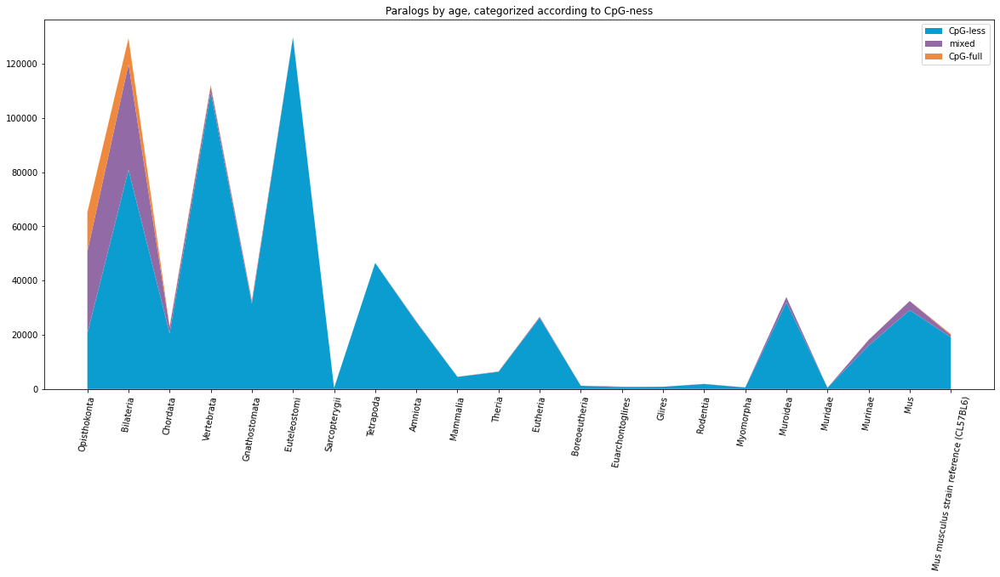

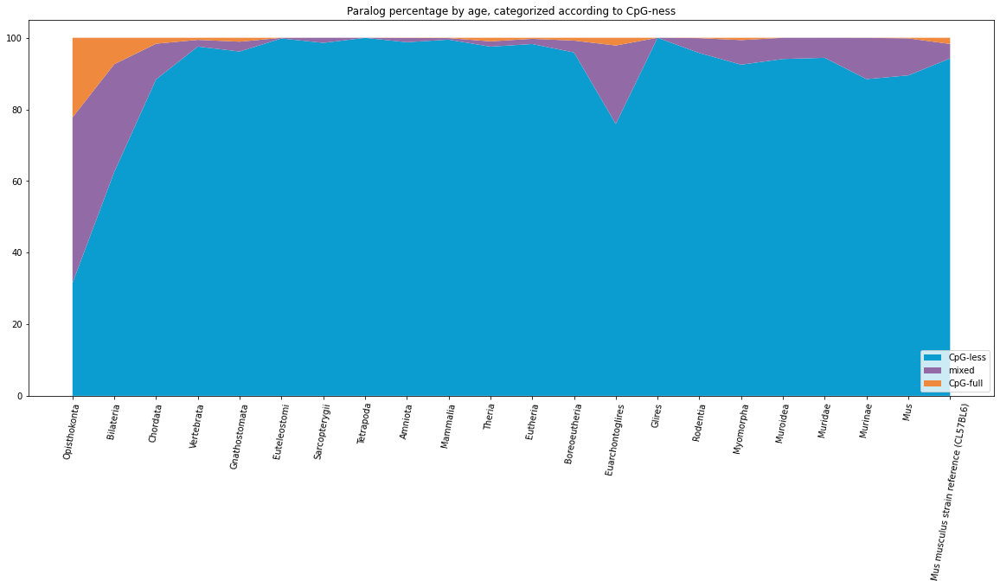

In [161]:
branch_points = {k:v for k,v in paralogs.items() if (export["Branch point"]==k).sum()>0}
from seaborn import countplot
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=80)
pyplot.stackplot(branch_order, [((export["CpG-ness"]==0)&(export["Branch point"]==b)).sum() for b in branch_order],
                  [((export["CpG-ness"]==1)&(export["Branch point"]==b)).sum() for b in branch_order],
                  [((export["CpG-ness"]==2)&(export["Branch point"]==b)).sum() for b in branch_order],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend()
pyplot.title('Paralogs by age, categorized according to CpG-ness')
pyplot.savefig('mouse-shpitzim-age-300bp-abs.pdf', dpi=600)
pyplot.show()
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=80)
pyplot.stackplot(branch_order, [((export["CpG-ness"]==0)&(export["Branch point"]==b)).sum()/(export["Branch point"]==b).sum()*100 for b in branch_order],
                  [((export["CpG-ness"]==1)&(export["Branch point"]==b)).sum()/(export["Branch point"]==b).sum()*100 for b in branch_order],
                  [((export["CpG-ness"]==2)&(export["Branch point"]==b)).sum()/(export["Branch point"]==b).sum()*100 for b in branch_order],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend(loc=4)
pyplot.title('Paralog percentage by age, categorized according to CpG-ness')
pyplot.savefig('mouse-shpitzim-age-300bp-pct.pdf', dpi=600)
pyplot.show()

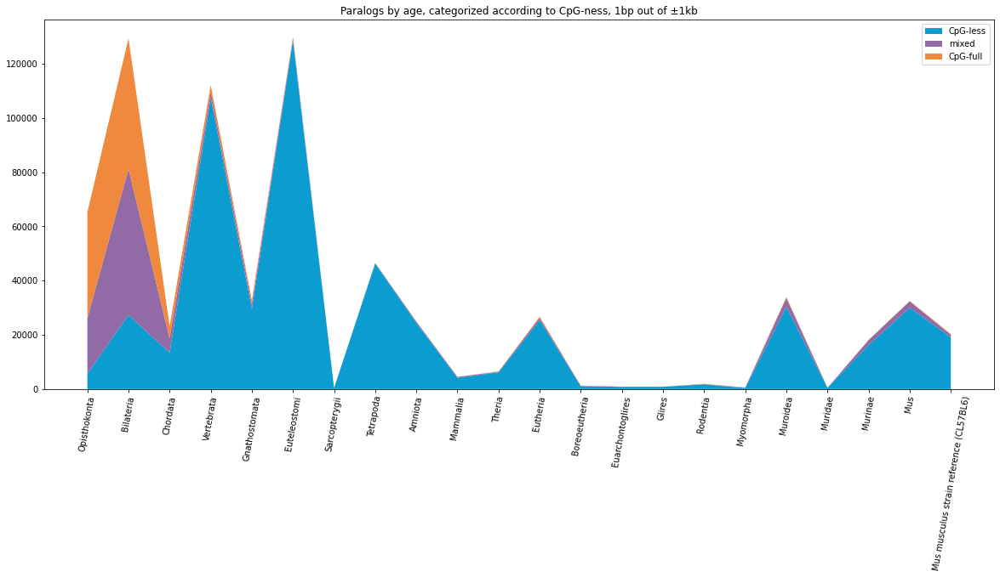

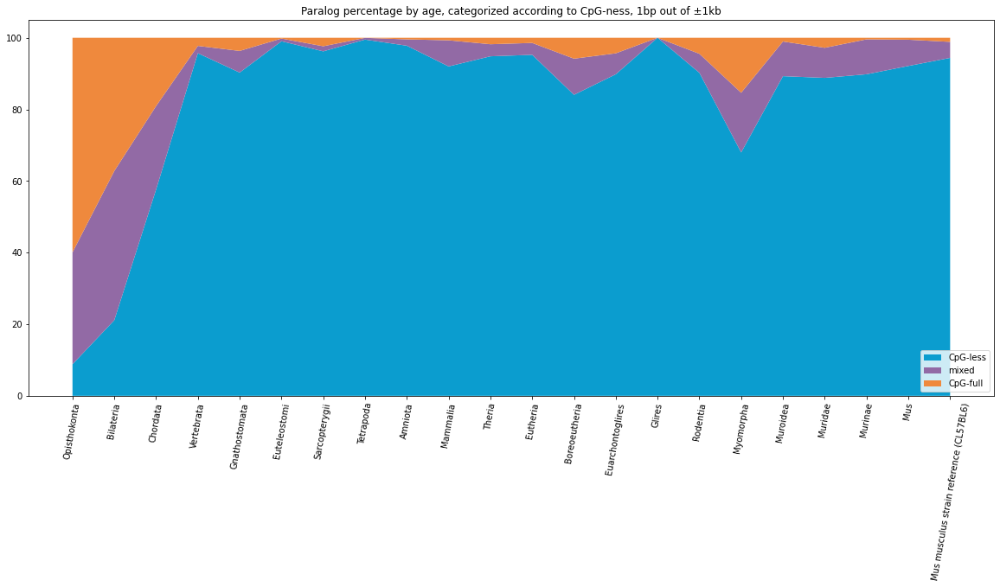

In [162]:
branch_points = {k:v for k,v in paralogs.items() if (export["Branch point"]==k).sum()>0}
from seaborn import countplot
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=80)
pyplot.stackplot(branch_order, [((export["mm_elife_overlaps"]==0)&(export["Branch point"]==b)).sum() for b in branch_order],
                  [((export["mm_elife_overlaps"]==1)&(export["Branch point"]==b)).sum() for b in branch_order],
                  [((export["mm_elife_overlaps"]==2)&(export["Branch point"]==b)).sum() for b in branch_order],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend()
pyplot.savefig('mouse-shpitzim-age-elife-abs.pdf', dpi=600)
pyplot.title('Paralogs by age, categorized according to CpG-ness, 1bp out of ±1kb')
pyplot.show()
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=80)
pyplot.stackplot(branch_order, [((export["mm_elife_overlaps"]==0)&(export["Branch point"]==b)).sum()/(export["Branch point"]==b).sum()*100 for b in branch_order],
                  [((export["mm_elife_overlaps"]==1)&(export["Branch point"]==b)).sum()/(export["Branch point"]==b).sum()*100 for b in branch_order],
                  [((export["mm_elife_overlaps"]==2)&(export["Branch point"]==b)).sum()/(export["Branch point"]==b).sum()*100 for b in branch_order],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend(loc=4)
pyplot.title('Paralog percentage by age, categorized according to CpG-ness, 1bp out of ±1kb')
pyplot.savefig('mouse-shpitzim-age-elife-pct.pdf', dpi=600)
pyplot.show()

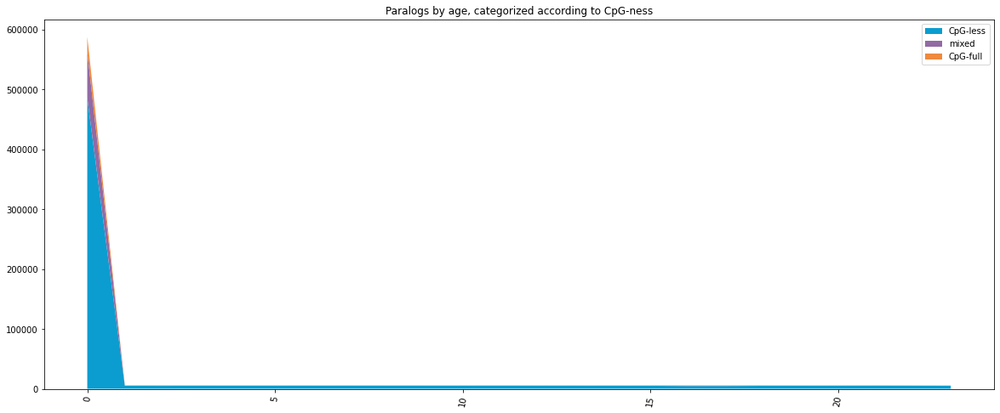

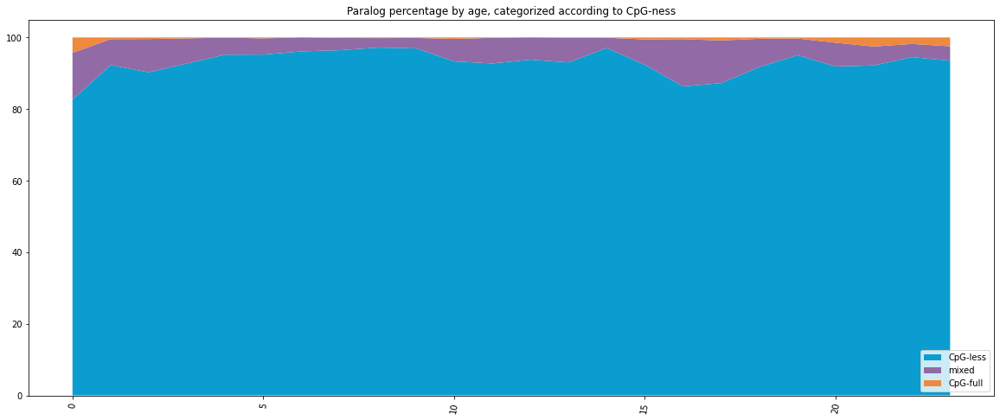

In [163]:
from seaborn import countplot
fig, ax = pyplot.subplots(figsize=(20, 8))
dsrange = range(min(export['dSbin']), max(export['dSbin'])+1)
pyplot.xticks(rotation=80)
pyplot.stackplot(dsrange, [((export["CpG-ness"]==0)&(export["dSbin"]==b)).sum() for b in dsrange],
                  [((export["CpG-ness"]==1)&(export["dSbin"]==b)).sum() for b in dsrange],
                  [((export["CpG-ness"]==2)&(export["dSbin"]==b)).sum() for b in dsrange],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend()
pyplot.title('Paralogs by age, categorized according to CpG-ness')
pyplot.savefig('mouse-shpitzim-ds-300bp-abs.pdf', dpi=600)
pyplot.show()
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=80)
pyplot.stackplot(dsrange, [((export["CpG-ness"]==0)&(export["dSbin"]==b)).sum()/(export["dSbin"]==b).sum()*100 for b in dsrange],
                  [((export["CpG-ness"]==1)&(export["dSbin"]==b)).sum()/(export["dSbin"]==b).sum()*100 for b in dsrange],
                  [((export["CpG-ness"]==2)&(export["dSbin"]==b)).sum()/(export["dSbin"]==b).sum()*100 for b in dsrange],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend(loc=4)
pyplot.title('Paralog percentage by age, categorized according to CpG-ness')
pyplot.savefig('mouse-shpitzim-ds-300bp-pct.pdf', dpi=600)
pyplot.show()

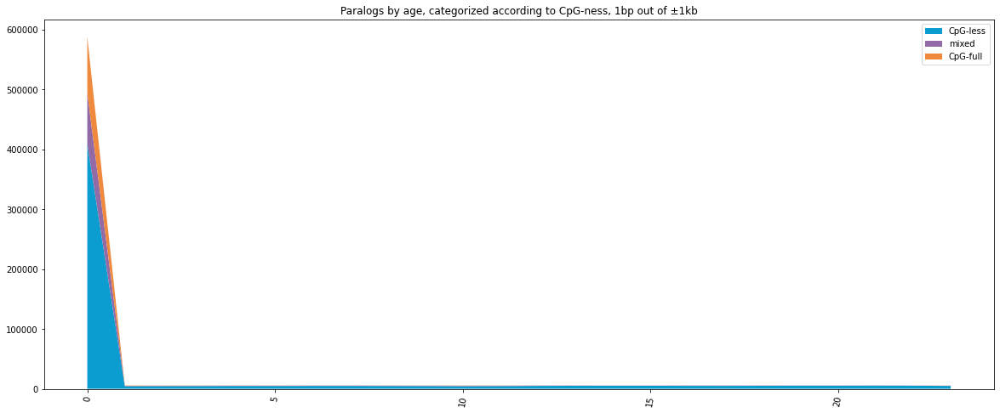

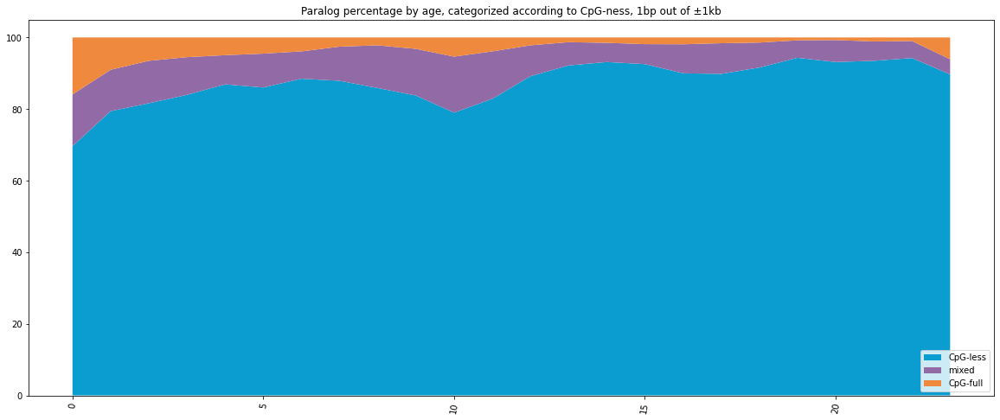

In [164]:
from seaborn import countplot
fig, ax = pyplot.subplots(figsize=(20, 8))
dsrange = range(min(export['dSbin']), max(export['dSbin'])+1)
pyplot.xticks(rotation=80)
pyplot.stackplot(dsrange, [((export["mm_elife_overlaps"]==0)&(export["dSbin"]==b)).sum() for b in dsrange],
                  [((export["mm_elife_overlaps"]==1)&(export["dSbin"]==b)).sum() for b in dsrange],
                  [((export["mm_elife_overlaps"]==2)&(export["dSbin"]==b)).sum() for b in dsrange],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend()
pyplot.title('Paralogs by age, categorized according to CpG-ness, 1bp out of ±1kb')
pyplot.savefig('mouse-shpitzim-ds-elife-abs.pdf', dpi=600)
pyplot.show()
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xticks(rotation=80)
pyplot.stackplot(dsrange, [((export["mm_elife_overlaps"]==0)&(export["dSbin"]==b)).sum()/(export["dSbin"]==b).sum()*100 for b in dsrange],
                  [((export["mm_elife_overlaps"]==1)&(export["dSbin"]==b)).sum()/(export["dSbin"]==b).sum()*100 for b in dsrange],
                  [((export["mm_elife_overlaps"]==2)&(export["dSbin"]==b)).sum()/(export["dSbin"]==b).sum()*100 for b in dsrange],
                  labels=['CpG-less', 'mixed', 'CpG-full'], colors=['#0b9dcf','#926aa5', '#ef893d'])
pyplot.legend(loc=4)
pyplot.title('Paralog percentage by age, categorized according to CpG-ness, 1bp out of ±1kb')
pyplot.savefig('mouse-shpitzim-ds-elife-pct.pdf', dpi=600)
pyplot.show()

In [165]:
import random
r=random.Random(972)
tests=100000
pop=list(export[export['g1']<export['g2']]['Branch point'])
cpgfulls=((export['CpG-ness']==2)&(export['g1']<export['g2'])).sum()
ourseq=[((export["CpG-ness"]==2)&(export['g1']<export['g2'])&(export["Branch point"]==b)).sum() for b in branch_order]
outliers=0
for t in range(0,tests):
    perm=r.sample(pop, cpgfulls)
    permseq=[sum([p==b for p in perm]) for b in branch_order]
    if min((x[0]-x[1] for x in zip(itertools.accumulate(ourseq), itertools.accumulate(permseq)))) < 0:
        outliers += 1
    


In [166]:
outliers

0

In [167]:
import random
r=random.Random(972)
tests=100000
pop=list(export[export['g1']<export['g2']]['dSbin'])
cpgfulls=((export['CpG-ness']==2)&(export['g1']<export['g2'])).sum()
ourseq=[((export["CpG-ness"]==2)&(export['g1']<export['g2'])&(export["dSbin"]==b)).sum() for b in dsrange]
outliers=0
for t in range(0,tests):
    perm=r.sample(pop, cpgfulls)
    permseq=[sum([p==b for p in perm]) for b in dsrange]
    if min((x[0]-x[1] for x in zip(itertools.accumulate(ourseq), itertools.accumulate(permseq)))) < 0:
        outliers += 1
    


In [168]:
outliers

19

In [169]:
import random
r=random.Random(972)
tests=100000
pop=list(export[export['g1']<export['g2']]['Branch point'])
cpgfulls=((export['mm_elife_overlaps']==2)&(export['g1']<export['g2'])).sum()
ourseq=[((export["mm_elife_overlaps"]==2)&(export['g1']<export['g2'])&(export["Branch point"]==b)).sum() for b in branch_order]
outliers=0
for t in range(0,tests):
    perm=r.sample(pop, cpgfulls)
    permseq=[sum([p==b for p in perm]) for b in branch_order]
    if min((x[0]-x[1] for x in zip(itertools.accumulate(ourseq), itertools.accumulate(permseq)))) < 0:
        outliers += 1
    
outliers

0

In [170]:
import random
r=random.Random(972)
tests=100000
pop=list(export[export['g1']<export['g2']]['dSbin'])
cpgfulls=((export['mm_elife_overlaps']==2)&(export['g1']<export['g2'])).sum()
ourseq=[((export["mm_elife_overlaps"]==2)&(export['g1']<export['g2'])&(export["dSbin"]==b)).sum() for b in dsrange]
outliers=0
for t in range(0,tests):
    perm=r.sample(pop, cpgfulls)
    permseq=[sum([p==b for p in perm]) for b in dsrange]
    if min((x[0]-x[1] for x in zip(itertools.accumulate(ourseq), itertools.accumulate(permseq)))) < 0:
        outliers += 1
    
outliers


0

In [8]:
export_index = { (export.iloc[i]['g1'], export.iloc[i]['g2']) : i for i in range(len(export)) }
export=export.assign(RevSim = [export.iloc[export_index[(r['g2'], r['g1'])]]['Similarity'] for r in export.iloc])

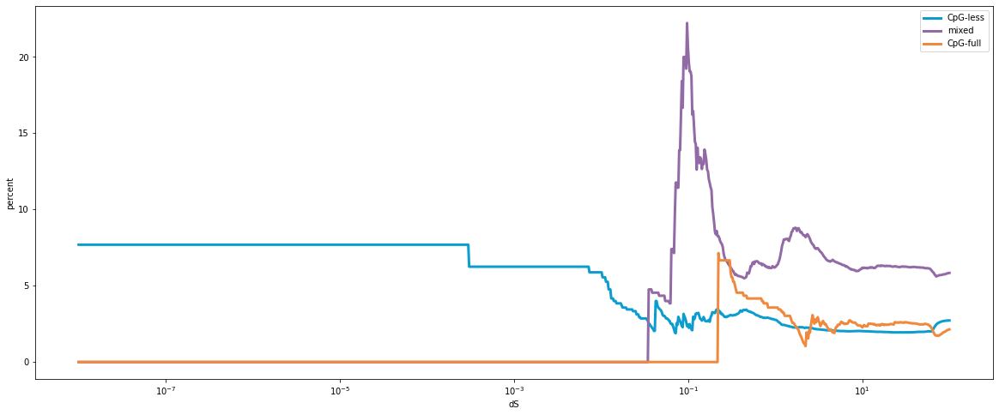

In [172]:
from matplotlib.pyplot import plot
X=np.logspace(-8, 2, 1000)
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set_xscale('log')
pyplot.xlabel('dS')
pyplot.ylabel('percent')
plot(X, [100*export[(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==0)]['NEO2'].sum()/((export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==0)).sum() for x in X], color='#0B9DCF', linewidth='3')
plot(X, [100*export[(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==1)]['NEO2'].sum()/((export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==1)).sum() for x in X], color='#926AA5', linewidth='3')
plot(X, [100*export[(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==2)]['NEO2'].sum()/((export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==2)).sum() for x in X], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['CpG-less', 'mixed', 'CpG-full'])
plt.savefig('mouse-neo2-ds-cumulative-from-group.pdf', dpi=600)

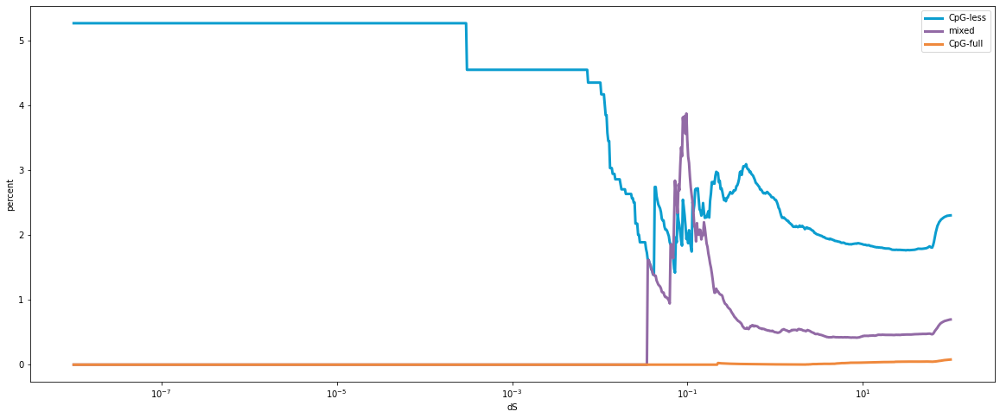

In [173]:
X=np.logspace(-8, 2, 1000)
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set_xscale('log')
pyplot.xlabel('dS')
pyplot.ylabel('percent')
plot(X, [100*export[(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==0)]['NEO2'].sum()/((export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)).sum() for x in X], color='#0B9DCF', linewidth='3')
plot(X, [100*export[(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==1)]['NEO2'].sum()/((export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)).sum() for x in X], color='#926AA5', linewidth='3')
plot(X, [100*export[(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==2)]['NEO2'].sum()/((export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)).sum() for x in X], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['CpG-less', 'mixed', 'CpG-full'])
plt.savefig('mouse-neo2-ds-cumulative-from-all.pdf', dpi=600)

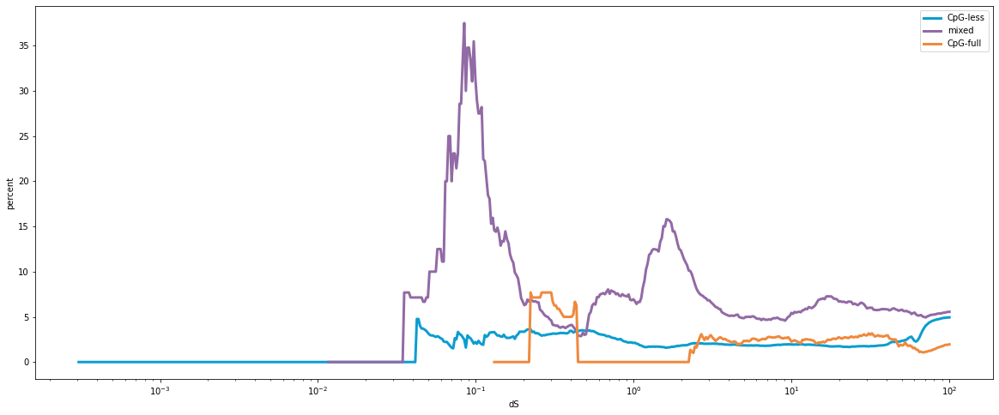

In [174]:
X=np.logspace(-8, 2, 1000)
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set_xscale('log')
pyplot.xlabel('dS')
pyplot.ylabel('percent')
def expDsBin(x, cpgness):
    return (export['dS']>=x/2)&(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
pyplot.plot([x for x in X if expDsBin(x, 0).sum()>0], [100*export[expDsBin(x,0)]['NEO2'].sum()/expDsBin(x,0).sum() for x in X if expDsBin(x, 0).sum()>0], color='#0B9DCF', linewidth='3')
pyplot.plot([x for x in X if expDsBin(x, 1).sum()>0], [100*export[expDsBin(x,1)]['NEO2'].sum()/expDsBin(x,1).sum() for x in X if expDsBin(x, 1).sum()>0], color='#926AA5', linewidth='3')
pyplot.plot([x for x in X if expDsBin(x, 2).sum()>0], [100*export[expDsBin(x,2)]['NEO2'].sum()/expDsBin(x,2).sum() for x in X if expDsBin(x, 2).sum()>0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['CpG-less', 'mixed', 'CpG-full'])
plt.savefig('mouse-neo2-ds-window-from-group.pdf', dpi=600)

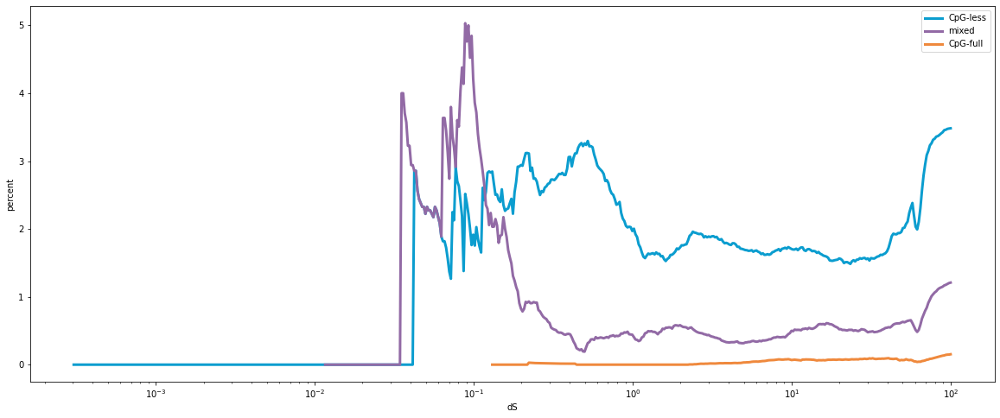

In [175]:
X=np.logspace(-8, 2, 1000)
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set_xscale('log')
pyplot.xlabel('dS')
pyplot.ylabel('percent')
def expDsBin(x, cpgness=None):
    if cpgness is None:
        return (export['dS']>=x/2)&(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)
    else:
        return (export['dS']>=x/2)&(export['dS']<x)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
pyplot.plot([x for x in X if expDsBin(x, 0).sum()>0], [100*export[expDsBin(x,0)]['NEO2'].sum()/expDsBin(x).sum() for x in X if expDsBin(x, 0).sum()>0], color='#0B9DCF', linewidth='3')
pyplot.plot([x for x in X if expDsBin(x, 1).sum()>0], [100*export[expDsBin(x,1)]['NEO2'].sum()/expDsBin(x).sum() for x in X if expDsBin(x, 1).sum()>0], color='#926AA5', linewidth='3')
pyplot.plot([x for x in X if expDsBin(x, 2).sum()>0], [100*export[expDsBin(x,2)]['NEO2'].sum()/expDsBin(x).sum() for x in X if expDsBin(x, 2).sum()>0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['CpG-less', 'mixed', 'CpG-full'])
plt.savefig('mouse-neo2-ds-window-from-all.pdf', dpi=600)

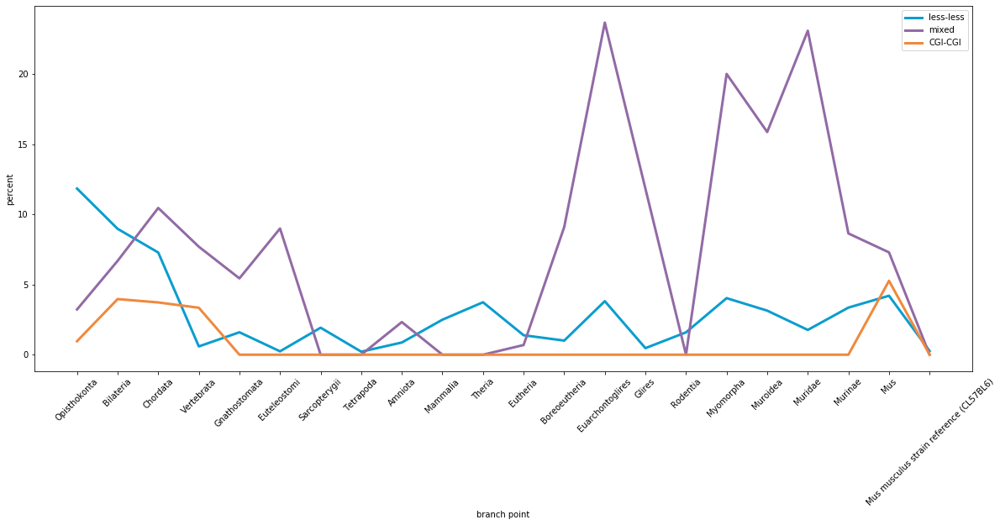

In [12]:
X=branch_order[::1]
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBin(b, cpgness):
    return (export['Branch point']==b)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBin(b,0).sum() > 0], [100*export[expBpBin(b,0)]['NEO2'].sum()/expBpBin(b,0).sum() for b in X if expBpBin(b,0).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBin(b,1).sum() > 0], [100*export[expBpBin(b,1)]['NEO2'].sum()/expBpBin(b,1).sum() for b in X if expBpBin(b,1).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBin(b,2).sum() > 0], [100*export[expBpBin(b,2)]['NEO2'].sum()/expBpBin(b,2).sum() for b in X if expBpBin(b,2).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-group.pdf', dpi=600)

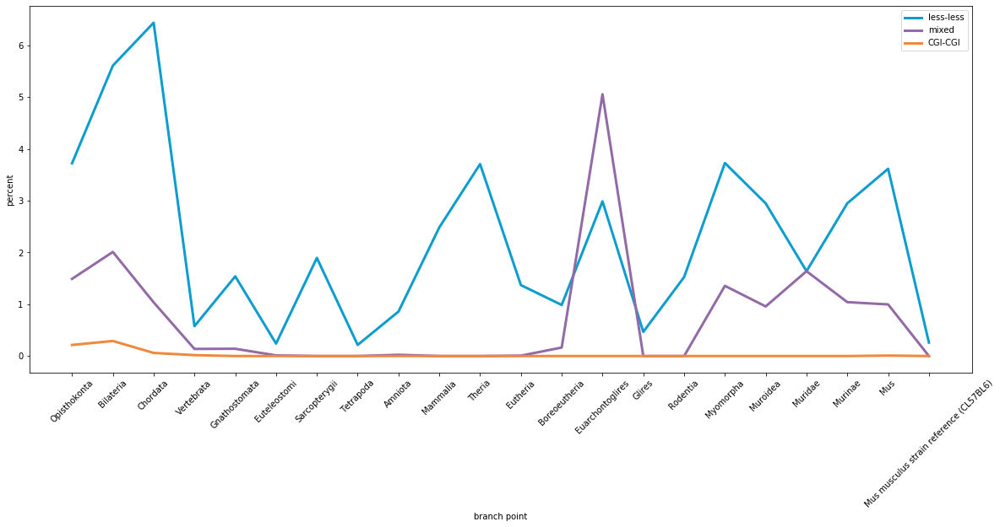

In [13]:
X=branch_order[::1]
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBin(b, cpgness=None):
    if cpgness is None:
        return (export['Branch point']==b)&(export['Similarity']<80)&(export['RevSim']<80)
    else:
        return (export['Branch point']==b)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBin(b).sum() > 0], [100*export[expBpBin(b,0)]['NEO2'].sum()/expBpBin(b).sum() for b in X if expBpBin(b).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBin(b).sum() > 0], [100*export[expBpBin(b,1)]['NEO2'].sum()/expBpBin(b).sum() for b in X if expBpBin(b).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBin(b).sum() > 0], [100*export[expBpBin(b,2)]['NEO2'].sum()/expBpBin(b).sum() for b in X if expBpBin(b).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-all.pdf', dpi=600)

Repeat without the smaller groups:

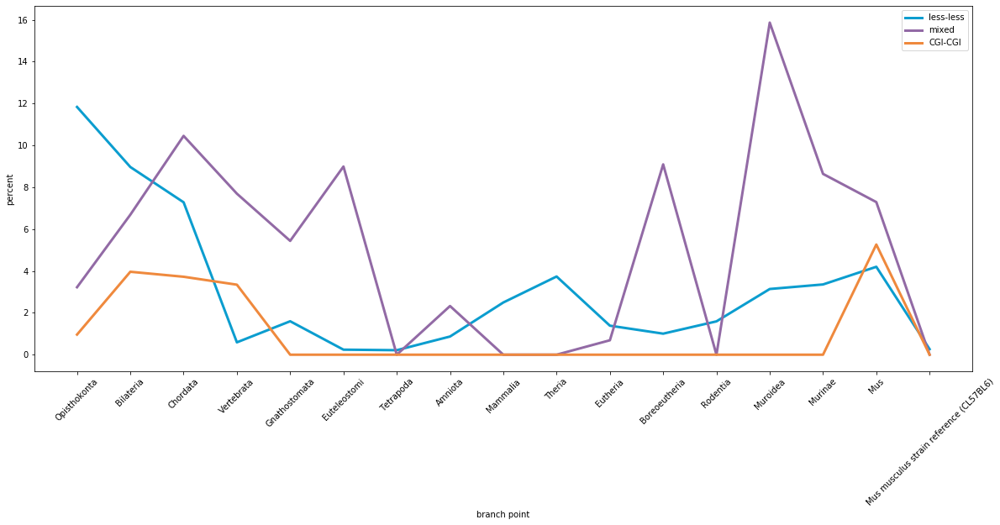

In [14]:
X=list(filter(lambda x: not x in ['Sarcopterygii','Glires','Euarchontoglires','Myomorpha','Muridae'], branch_order[::1]))
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBin(b, cpgness):
    return (export['Branch point']==b)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBin(b,0).sum() > 0], [100*export[expBpBin(b,0)]['NEO2'].sum()/expBpBin(b,0).sum() for b in X if expBpBin(b,0).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBin(b,1).sum() > 0], [100*export[expBpBin(b,1)]['NEO2'].sum()/expBpBin(b,1).sum() for b in X if expBpBin(b,1).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBin(b,2).sum() > 0], [100*export[expBpBin(b,2)]['NEO2'].sum()/expBpBin(b,2).sum() for b in X if expBpBin(b,2).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-group-no-small-groups.pdf', dpi=600)

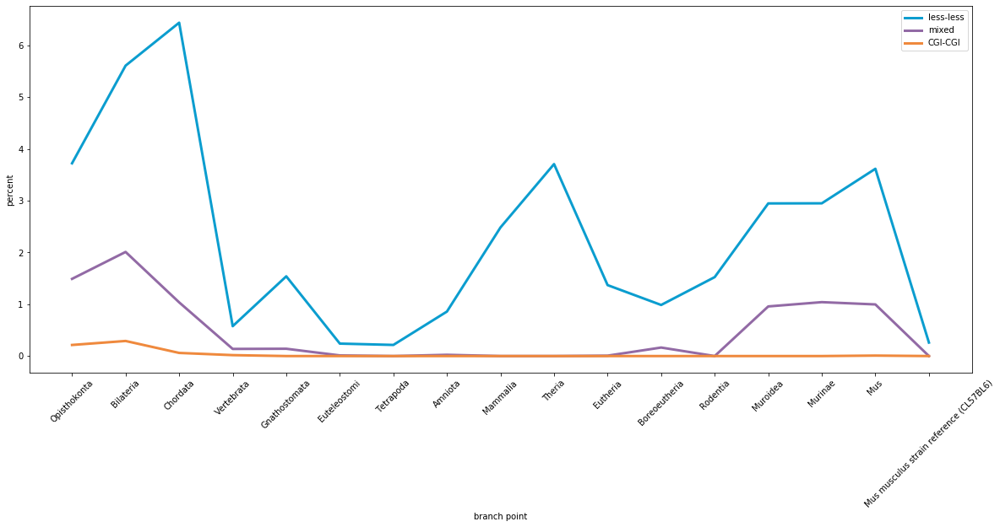

In [15]:
X=list(filter(lambda x: not x in ['Sarcopterygii','Glires','Euarchontoglires','Myomorpha','Muridae'], branch_order[::1]))
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBin(b, cpgness=None):
    if cpgness is None:
        return (export['Branch point']==b)&(export['Similarity']<80)&(export['RevSim']<80)
    else:
        return (export['Branch point']==b)&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBin(b).sum() > 0], [100*export[expBpBin(b,0)]['NEO2'].sum()/expBpBin(b).sum() for b in X if expBpBin(b).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBin(b).sum() > 0], [100*export[expBpBin(b,1)]['NEO2'].sum()/expBpBin(b).sum() for b in X if expBpBin(b).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBin(b).sum() > 0], [100*export[expBpBin(b,2)]['NEO2'].sum()/expBpBin(b).sum() for b in X if expBpBin(b).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-all-no-small-groups.pdf', dpi=600)

And now cumulative by branch:

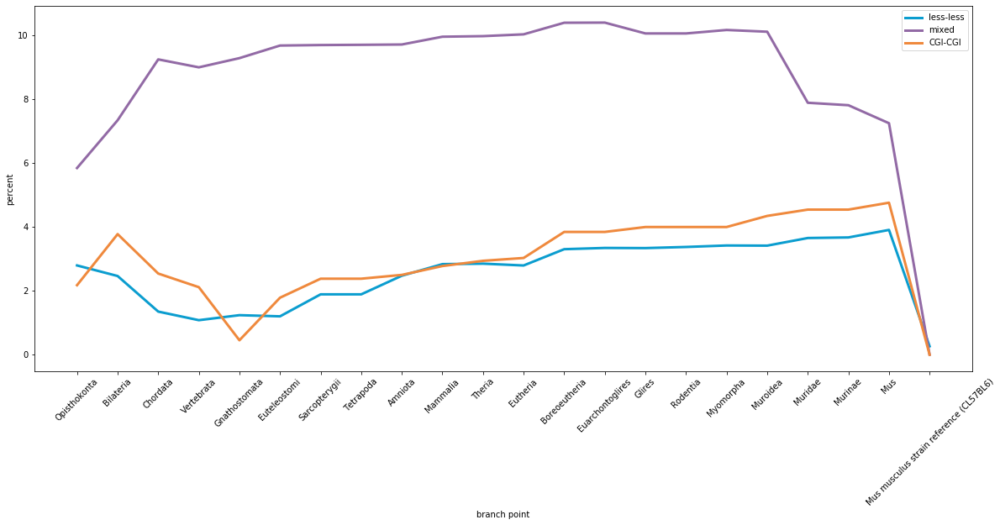

In [16]:
X=branch_order[::1]
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBinCum(b, cpgness):
    return (export['Branch point'].isin(X[X.index(b):]))&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBinCum(b,0).sum() > 0], [100*export[expBpBinCum(b,0)]['NEO2'].sum()/expBpBinCum(b,0).sum() for b in X if expBpBinCum(b,0).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBinCum(b,1).sum() > 0], [100*export[expBpBinCum(b,1)]['NEO2'].sum()/expBpBinCum(b,1).sum() for b in X if expBpBinCum(b,1).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBinCum(b,2).sum() > 0], [100*export[expBpBinCum(b,2)]['NEO2'].sum()/expBpBinCum(b,2).sum() for b in X if expBpBinCum(b,2).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-group-cumulative-new-to-old.pdf', dpi=600)

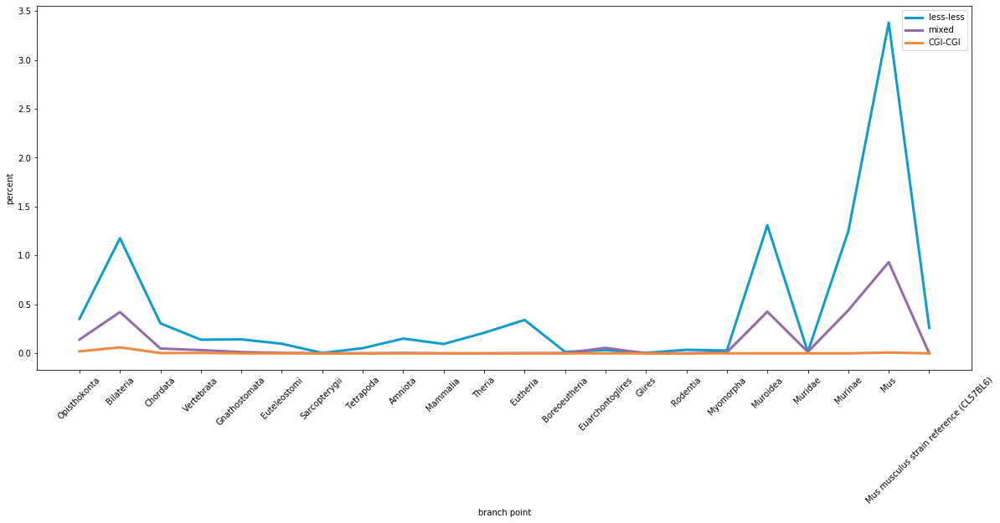

In [17]:
X=branch_order[::1]
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBinCum(b, cpgness=None):
    if cpgness is None:
        return (export['Branch point'].isin(X[X.index(b):]))&(export['Similarity']<80)&(export['RevSim']<80)
    else:
        return (export['Branch point'].isin(X[X.index(b):]))&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBinCum(b).sum() > 0], [100*export[expBpBin(b,0)]['NEO2'].sum()/expBpBinCum(b).sum() for b in X if expBpBinCum(b).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBinCum(b).sum() > 0], [100*export[expBpBin(b,1)]['NEO2'].sum()/expBpBinCum(b).sum() for b in X if expBpBinCum(b).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBinCum(b).sum() > 0], [100*export[expBpBin(b,2)]['NEO2'].sum()/expBpBinCum(b).sum() for b in X if expBpBinCum(b).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-all-cumulative-new-to-old.pdf', dpi=600)

And now cumulative Opisthokonta first by branch:

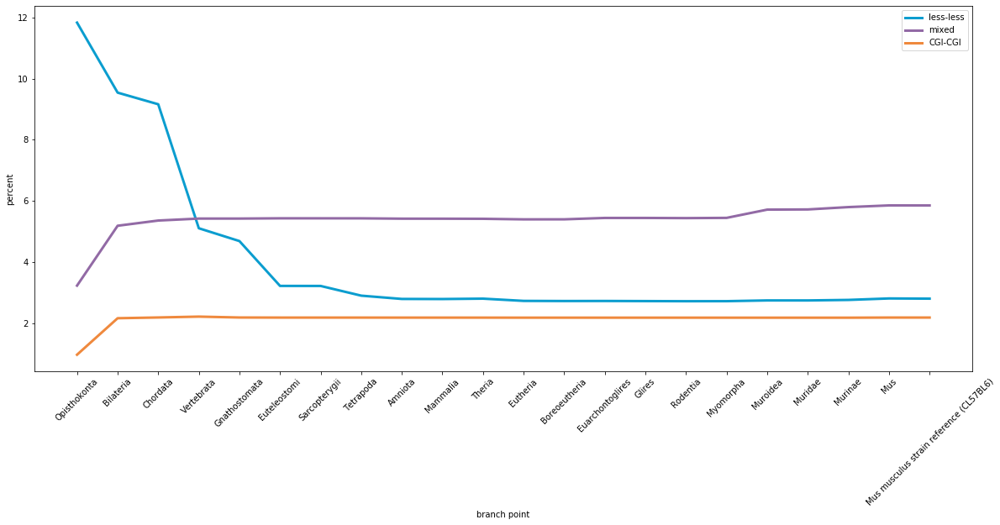

In [18]:
X=branch_order[::1]
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBinCum(b, cpgness):
    return (export['Branch point'].isin(X[:X.index(b)+1]))&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBinCum(b,0).sum() > 0], [100*export[expBpBinCum(b,0)]['NEO2'].sum()/expBpBinCum(b,0).sum() for b in X if expBpBinCum(b,0).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBinCum(b,1).sum() > 0], [100*export[expBpBinCum(b,1)]['NEO2'].sum()/expBpBinCum(b,1).sum() for b in X if expBpBinCum(b,1).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBinCum(b,2).sum() > 0], [100*export[expBpBinCum(b,2)]['NEO2'].sum()/expBpBinCum(b,2).sum() for b in X if expBpBinCum(b,2).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-group-cumulative-old-to-new.pdf', dpi=600)

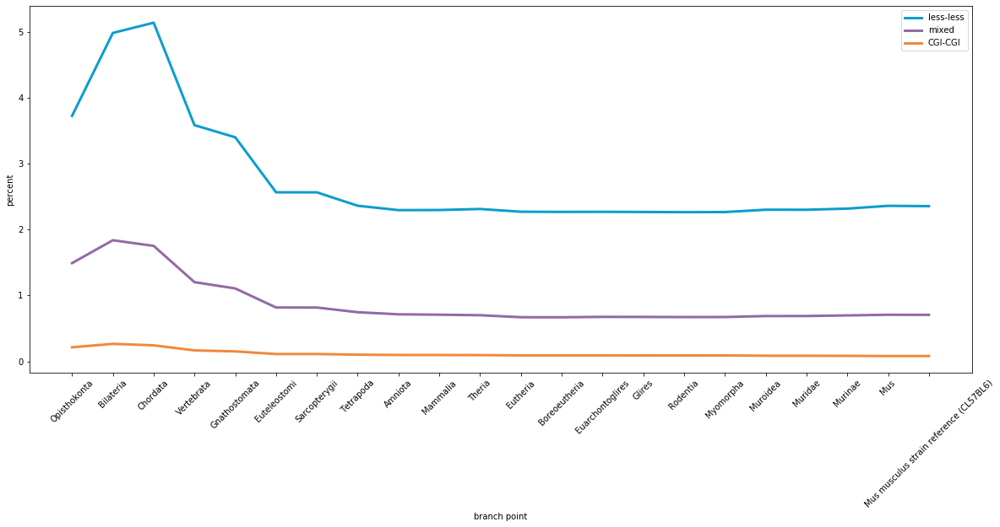

In [19]:
X=branch_order[::1]
fig, ax = pyplot.subplots(figsize=(20, 8))
pyplot.xlabel('branch point')
pyplot.ylabel('percent')
pyplot.xticks(rotation=45)
def expBpBinCum(b, cpgness=None):
    if cpgness is None:
        return (export['Branch point'].isin(X[:X.index(b)+1]))&(export['Similarity']<80)&(export['RevSim']<80)
    else:
        return (export['Branch point'].isin(X[:X.index(b)+1]))&(export['Similarity']<80)&(export['RevSim']<80)&(export["CpG-ness"]==cpgness)
plot([b for b in X if expBpBinCum(b).sum() > 0], [100*export[expBpBinCum(b,0)]['NEO2'].sum()/expBpBinCum(b).sum() for b in X if expBpBinCum(b).sum() > 0], color='#0B9DCF', linewidth='3')
plot([b for b in X if expBpBinCum(b).sum() > 0], [100*export[expBpBinCum(b,1)]['NEO2'].sum()/expBpBinCum(b).sum() for b in X if expBpBinCum(b).sum() > 0], color='#926AA5', linewidth='3')
plot([b for b in X if expBpBinCum(b).sum() > 0], [100*export[expBpBinCum(b,2)]['NEO2'].sum()/expBpBinCum(b).sum() for b in X if expBpBinCum(b).sum() > 0], color='#EF893D', linewidth='3')
#plot(X, [100*export[export['dS']<x]['NEO'].sum()/(export['dS']<x).sum() for x in X])
ax.legend(['less-less', 'mixed', 'CGI-CGI'])
plt.savefig('mouse-neo2-bp-bin-from-all-cumulative-old-to-new.pdf', dpi=600)

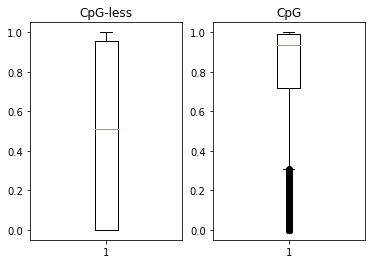

In [184]:
from matplotlib import pyplot as plt
fam_pvalues = {'gene:'+v.split()[0]:float(v.split()[1]) for v in open('mouse-genes-p-value.txt').readlines()}
plt.subplot(1,2,1, title='CpG-less')
plt.boxplot([fam_pvalues[g] for g in cpg_less if g in fam_pvalues])
plt.subplot(1,2,2, title='CpG')
plt.boxplot([fam_pvalues[g] for g in cpg_full if g in fam_pvalues])
plt.savefig('mouse-gene-gain-and-loss-pvalue.pdf', dpi=600)
 

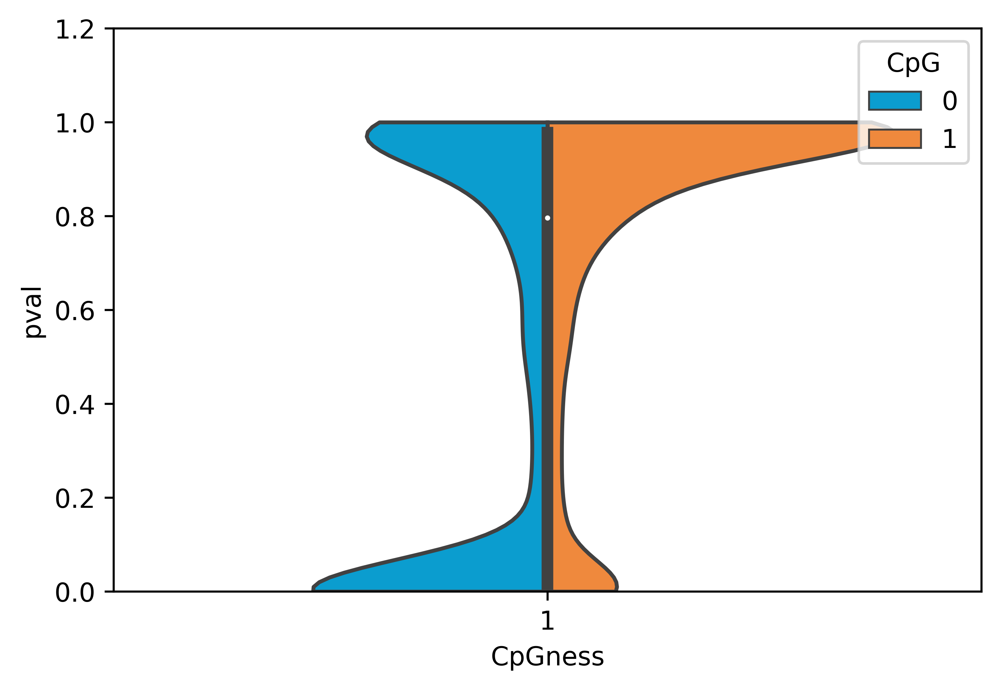

In [185]:
from matplotlib import pyplot as plt
from seaborn import violinplot
fam_pvalues = {'gene:'+v.split()[0]:float(v.split()[1]) for v in open('mouse-genes-p-value.txt').readlines()}
fig, ax = plt.subplots(dpi=600)
plt.ylim(0.0, 1.2)
violinplot(ax=ax, data=pd.concat((DataFrame({'pval':[fam_pvalues[g] for g in cpg_less if g in fam_pvalues]}).assign(CpG=0), DataFrame({'pval':[fam_pvalues[g] for g in cpg_full if g in fam_pvalues]}).assign(CpG=1))).assign(CpGness=1),
           x='CpGness', y='pval', hue='CpG', split=True, cut=0, saturation=1.0, palette=['#0B9DCF', '#EF893D'])
plt.savefig('mouse-gene-gain-and-loss-pvalue-violin.pdf')
 

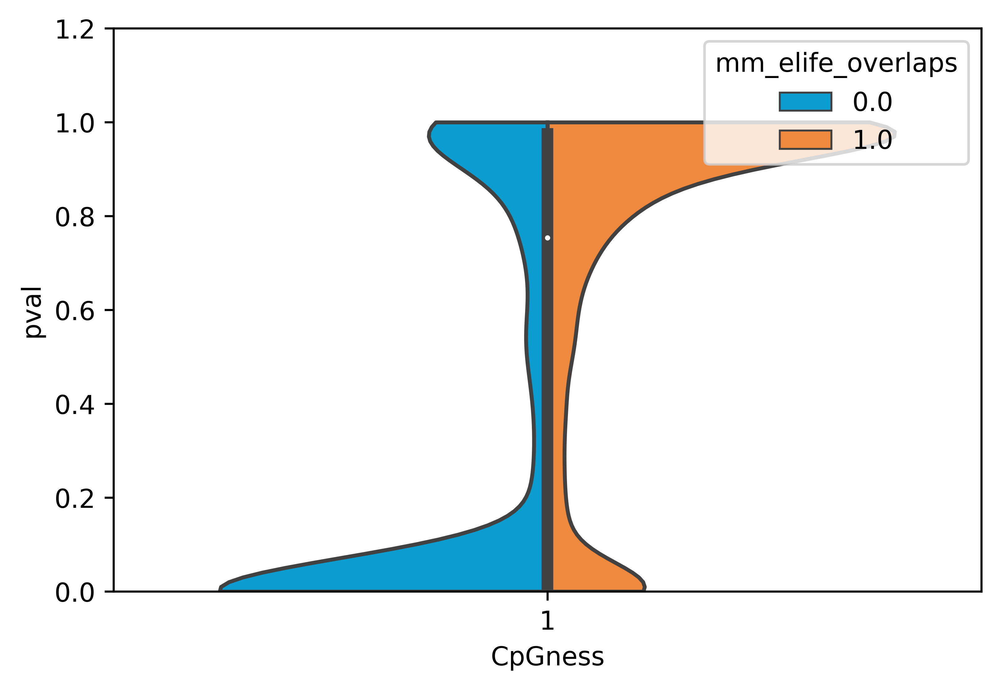

In [186]:
from matplotlib import pyplot as plt
from seaborn import violinplot
fam_pvalues = {v.split()[0]:float(v.split()[1]) for v in open('mouse-genes-p-value.txt').readlines()}
fig, ax = plt.subplots(dpi=600)
plt.ylim(0.0, 1.2)
violinplot(ax=ax, data=DataFrame.from_dict(fam_pvalues, orient='index', columns=['pval']).join(exp_genes['mm_elife_overlaps']).assign(CpGness=1),
           x='CpGness', y='pval', hue='mm_elife_overlaps', split=True, cut=0, saturation=1.0, palette=['#0B9DCF', '#EF893D'])
plt.savefig('mouse-gene-gain-and-loss-pvalue-violin-elife.pdf')
 

In [187]:
from scipy.stats import mannwhitneyu
print('Mann-Whitney on -300+100: 50%% %s'%str(mannwhitneyu([fam_pvalues[g] for g in exp_genes[exp_genes['mouse_overlaps_ensembl_300']<0.5].index if g in fam_pvalues], [fam_pvalues[g] for g in exp_genes[exp_genes['mouse_overlaps_ensembl_300']>=0.5].index if g in fam_pvalues], alternative='less')))
print('Mann-Whitney on -1000+1000: 1bp %s'%str(mannwhitneyu([fam_pvalues[g] for g in exp_genes[exp_genes['mm_elife_overlaps']<0.5].index if g in fam_pvalues], [fam_pvalues[g] for g in exp_genes[exp_genes['mm_elife_overlaps']>=0.5].index if g in fam_pvalues], alternative='less')))

Mann-Whitney on -300+100: 50% MannwhitneyuResult(statistic=32040673.0, pvalue=0.0)
Mann-Whitney on -1000+1000: 1bp MannwhitneyuResult(statistic=27434066.5, pvalue=0.0)


In [188]:
neo_para = export[export['NEO2']==True]


In [189]:
def para_corr(x, y):
    from numpy import corrcoef
    from numpy import isfinite
    res = abs(corrcoef(x,y)[0,1])
    return 1.0-res if isfinite(res) else 1.0

from scipy.cluster.hierarchy import linkage

In [190]:
neo_para[(neo_para['g1']<neo_para['g2'])&(neo_para['Branch point'].isin(["Glires", "Rodentia", "Myomorpha", "Muroidea", "Muridae", "Murinae", "Mus", "Mus musculus strain reference (CL57BL6)"]))]

,Branch point,CpG-ness,dN,dS,Similarity,Length,Distance,g1,g2,dSbin,...,uterus-female-mean-log-diff,vesicular gland-female-mean-log-diff,vesicular gland-male-mean-log-diff,-mean-log-diff,mx,mn,mxidx,mnidx,NEO2,RevSim
605200,Glires,0,0.2016,0.8092,69.5652,25446.0,300000000,ENSMUSG00000025955,ENSMUSG00000033715,10,...,-4.120038,-3.488226,0.0,0.0,5.243892,7.197489,adrenal gland-male-mean-log-diff,liver-male-mean-log-diff,True,69.3498
605207,Glires,0,0.1813,0.8708,72.4458,27023.0,374715,ENSMUSG00000021210,ENSMUSG00000033715,10,...,-4.580338,-6.878683,0.0,0.0,1.461586,20.000000,liver-female-mean-log-diff,stomach-male-mean-log-diff,True,72.4458
605616,Rodentia,0,0.4487,1.0176,49.0385,3177.5,300000000,ENSMUSG00000059108,ENSMUSG00000065968,9,...,6.433313,15.002967,0.0,0.0,20.000000,20.000000,bone marrow-female-mean-log-diff,testis-male-mean-log-diff,True,36.1702
605753,Rodentia,0,0.3769,0.8253,53.9823,6155.5,191679,ENSMUSG00000068299,ENSMUSG00000089694,10,...,0.000000,0.000000,0.0,0.0,20.000000,1.589569,small intestine-female-mean-log-diff,kidney-female-mean-log-diff,True,53.7445
605990,Rodentia,0,0.3362,0.7518,57.6613,6008.5,60057,ENSMUSG00000015443,ENSMUSG00000079186,11,...,-20.000000,-20.000000,0.0,0.0,3.413026,20.000000,testis-male-mean-log-diff,forestomach-female-mean-log-diff,True,57.6613
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
712689,Mus musculus strain reference (CL57BL6),0,0.0026,0.0089,99.3976,8937.0,300000000,ENSMUSG00000101667,ENSMUSG00000102053,22,...,0.000000,0.000000,0.0,0.0,6.121110,16.818030,bone marrow-male-mean-log-diff,testis-male-mean-log-diff,True,43.4211
712765,Mus musculus strain reference (CL57BL6),1,0.0000,0.0000,100.0000,2676.5,300000000,ENSMUSG00000093828,ENSMUSG00000095247,23,...,0.000000,0.000000,0.0,0.0,20.000000,20.000000,adrenal gland-female-mean-log-diff,brain-female-mean-log-diff,True,95.5556
712789,Mus musculus strain reference (CL57BL6),0,0.0000,0.0000,100.0000,5538.0,300000000,ENSMUSG00000078735,ENSMUSG00000095456,23,...,0.000000,0.000000,0.0,0.0,20.000000,17.679950,testis-male-mean-log-diff,heart-male-mean-log-diff,True,100.0000
713009,Mus musculus strain reference (CL57BL6),0,0.0057,0.0350,98.7382,24599.5,16618,ENSMUSG00000056148,ENSMUSG00000099009,21,...,-3.228051,0.000000,0.0,0.0,20.000000,20.000000,large intestine-female-mean-log-diff,spleen-male-mean-log-diff,True,98.7382


<AxesSubplot:ylabel='g1-g2'>

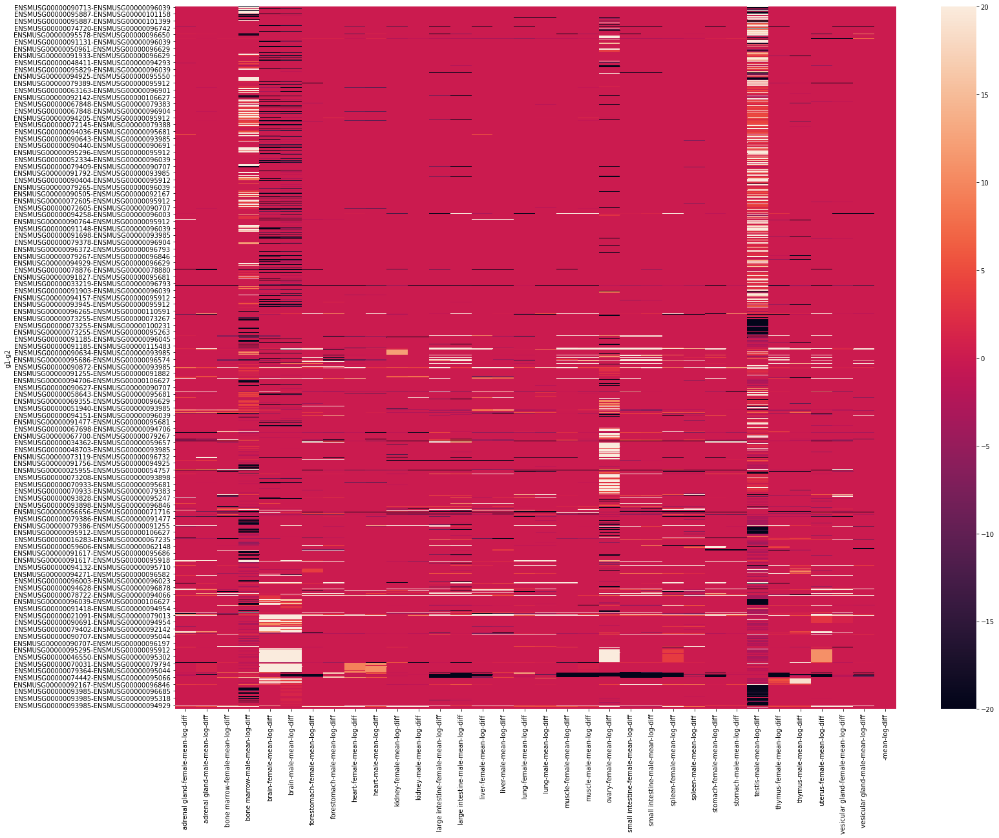

In [191]:
from seaborn import heatmap
fig, ax = pyplot.subplots(figsize=(25,20))
#"Glires", "Rodentia", "Myomorpha", "Muroidea", "Muridae", "Murinae", "Mus", "Mus musculus strain reference (CL57BL6)"
heatmap(ax=ax, data=neo_para[(neo_para['g1']<neo_para['g2'])&(neo_para['Branch point'].isin(["Glires", "Rodentia", "Myomorpha", "Muroidea", "Muridae", "Murinae", "Mus", "Mus musculus strain reference (CL57BL6)"]))].sort_values(by=['Entropy-g1']).set_index(['g1','g2'])[[c for c in neo_para.columns if c.endswith('-mean-log-diff')]])

/home/gencpg/.local/lib/python3.6/site-packages/numpy/lib/function_base.py:2559: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/gencpg/.local/lib/python3.6/site-packages/numpy/lib/function_base.py:2560: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/gencpg/.local/lib/python3.6/site-packages/seaborn/matrix.py:659: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


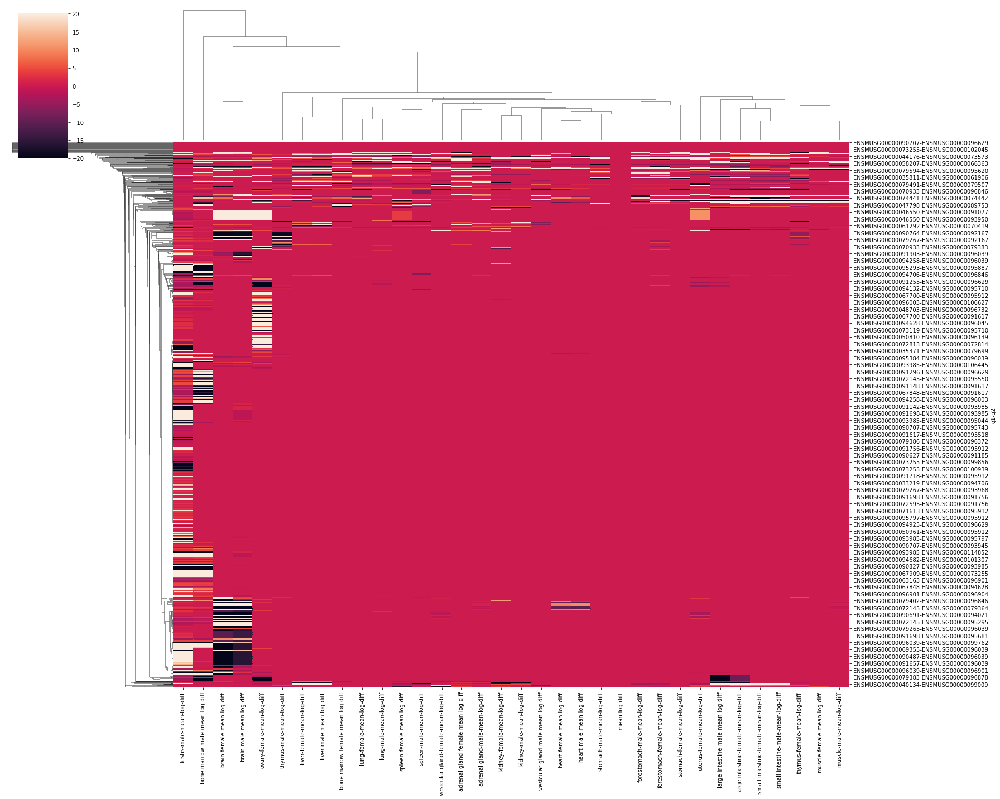

In [192]:
from seaborn import clustermap
from scipy.cluster.hierarchy import cut_tree
#"Primates", "Haplorrhini", "Simiiformes", "Catarrhini","Hominoidea", "Hominidae", "Homininae", "Homo sapiens"
filt_neo_para = neo_para[(neo_para['g1']<neo_para['g2'])&(neo_para['Branch point'].isin(["Glires", "Rodentia", "Myomorpha", "Muroidea", "Muridae", "Murinae", "Mus", "Mus musculus strain reference (CL57BL6)"]))].sort_values(by=['Entropy-g1'])
filt_neo_para_data = filt_neo_para.set_index(['g1','g2'])[[c for c in neo_para.columns if c.endswith('-mean-log-diff')]]
cluster=clustermap(figsize=(25,20), data=filt_neo_para_data, row_linkage=linkage(filt_neo_para_data, 'single', para_corr))
filt_neo_para.assign(clust=[i[0] for i in cut_tree(cluster.dendrogram_row.linkage,15)]).iloc[cluster.dendrogram_row.reordered_ind].assign(similarity=[1.0-para_corr(x[0], x[1]) for x in zip(filt_neo_para_data.iloc[cluster.dendrogram_row.reordered_ind[0:-1]].iloc,filt_neo_para_data.iloc[cluster.dendrogram_row.reordered_ind[1:]].iloc)]+[0.0]).iloc[cluster.dendrogram_row.reordered_ind].to_csv('small-mouse-paralog-clusters.csv')

cluster

In [193]:
import dendrogram
import importlib
importlib.reload(dendrogram)
dendrogram.HeatmapDisplay(cluster)

In [194]:
%%capture out
from seaborn import clustermap
from scipy.cluster.hierarchy import cut_tree
filt_neo_para=neo_para[neo_para['g1']<neo_para['g2']].sort_values(by=['Entropy-g1'])
filt_neo_para_data = filt_neo_para.set_index(['g1','g2'])[[c for c in neo_para.columns if c.endswith('-mean-log-diff')]]
import sys
sys.setrecursionlimit(10000)
#linkage(filt_neo_para_data, 'single', para_corr)
cluster=clustermap(figsize=(25,900), data=filt_neo_para_data, row_linkage=linkage(filt_neo_para_data, 'single', para_corr))
filt_neo_para.assign(clust=[i[0] for i in cut_tree(cluster.dendrogram_row.linkage,1000)]).iloc[cluster.dendrogram_row.reordered_ind].assign(similarity=[1.0-para_corr(x[0], x[1]) for x in zip(filt_neo_para_data.iloc[cluster.dendrogram_row.reordered_ind[0:-1]].iloc,filt_neo_para_data.iloc[cluster.dendrogram_row.reordered_ind[1:]].iloc)]+[0.0]).to_csv('large-mouse-paralog-clusters.csv')


In [195]:
open('para-mouse-large.png', 'wb').write(out.outputs[0].data['image/png'])


8708200

In [196]:
import dendrogram
dendrogram.HeatmapDisplay(cluster)

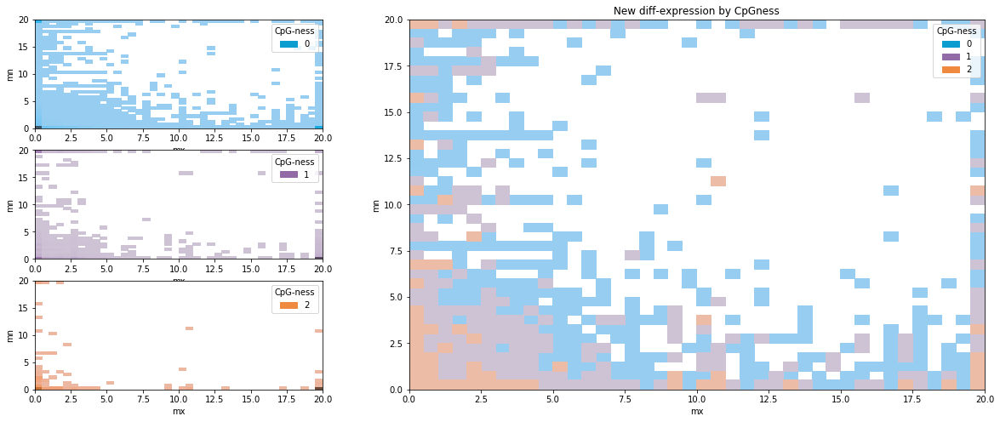

In [25]:
from seaborn import histplot
diffcols = [c for c in export.columns if c.endswith('-mean-log-diff')]
neo_para_recent = export[(export['g1']<export['g2'])&(export['Branch point'].isin(["Glires", "Rodentia", "Myomorpha", "Muroidea", "Muridae", "Murinae", "Mus", "Mus musculus strain reference (CL57BL6)"]))]
neo_para_recent = neo_para_recent.set_index(['g1','g2'])
neo_para_recent = neo_para_recent.assign(mx=neo_para_recent[diffcols].max(axis=1), mn=-neo_para_recent[diffcols].min(axis=1))[['mx', 'mn', 'CpG-ness']]

fig, ax = pyplot.subplots(figsize=(20,8), nrows=3, ncols=2, gridspec_kw={'width_ratios':[1,2]})
histplot(ax=ax[0,0], data=neo_para_recent[(neo_para_recent['mx']>=0) & (neo_para_recent['mn']>=0) & (neo_para_recent['CpG-ness']==0)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#0B9DCF'])
histplot(ax=ax[1,0], data=neo_para_recent[(neo_para_recent['mx']>=0) & (neo_para_recent['mn']>=0) & (neo_para_recent['CpG-ness']==1)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#926AA5'])
histplot(ax=ax[2,0], data=neo_para_recent[(neo_para_recent['mx']>=0) & (neo_para_recent['mn']>=0) & (neo_para_recent['CpG-ness']==2)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#EF893D'])
gs = ax[0, 1].get_gridspec()
for a in ax[:, -1]:
  a.remove()
axbig = fig.add_subplot(gs[:, -1])

histplot(ax=axbig, data=neo_para_recent[(neo_para_recent['mx']>=0) & (neo_para_recent['mn']>=0)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#0B9DCF','#926AA5','#EF893D'])
title('New diff-expression by CpGness')
import matplotlib.pyplot as plt
plt.savefig('mouse-diff-expression-new.pdf', dpi=600)

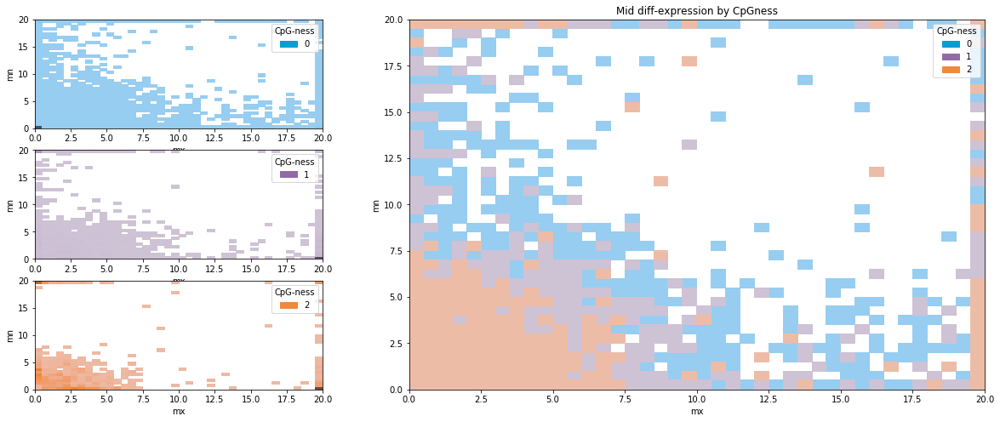

In [26]:
diffcols = [c for c in export.columns if c.endswith('-mean-log-diff')]
neo_para_mid = export[(export['g1']<export['g2'])&(~export['Branch point'].isin(["Opisthokonta", "Bilateria", "Glires", "Rodentia", "Myomorpha", "Muroidea", "Muridae", "Murinae", "Mus", "Mus musculus strain reference (CL57BL6)"]))]
neo_para_mid = neo_para_mid.set_index(['g1','g2'])
neo_para_mid = neo_para_mid.assign(mx=neo_para_mid[diffcols].max(axis=1), mn=-neo_para_mid[diffcols].min(axis=1))[['mx', 'mn', 'CpG-ness']]

fig, ax = pyplot.subplots(figsize=(20,8), nrows=3, ncols=2, gridspec_kw={'width_ratios':[1,2]})
histplot(ax=ax[0,0], data=neo_para_mid[(neo_para_mid['mx']>=0) & (neo_para_mid['mn']>=0) & (neo_para_mid['CpG-ness']==0)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#0B9DCF'])
histplot(ax=ax[1,0], data=neo_para_mid[(neo_para_mid['mx']>=0) & (neo_para_mid['mn']>=0) & (neo_para_mid['CpG-ness']==1)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#926AA5'])
histplot(ax=ax[2,0], data=neo_para_mid[(neo_para_mid['mx']>=0) & (neo_para_mid['mn']>=0) & (neo_para_mid['CpG-ness']==2)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#EF893D'])
gs = ax[0, 1].get_gridspec()
for a in ax[:, -1]:
  a.remove()
axbig = fig.add_subplot(gs[:, -1])

histplot(ax=axbig, data=neo_para_mid[(neo_para_mid['mx']>=0) & (neo_para_mid['mn']>=0)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#0B9DCF','#926AA5','#EF893D'])

title('Mid diff-expression by CpGness')
plt.savefig('mouse-diff-expression-mid.pdf', dpi=600)

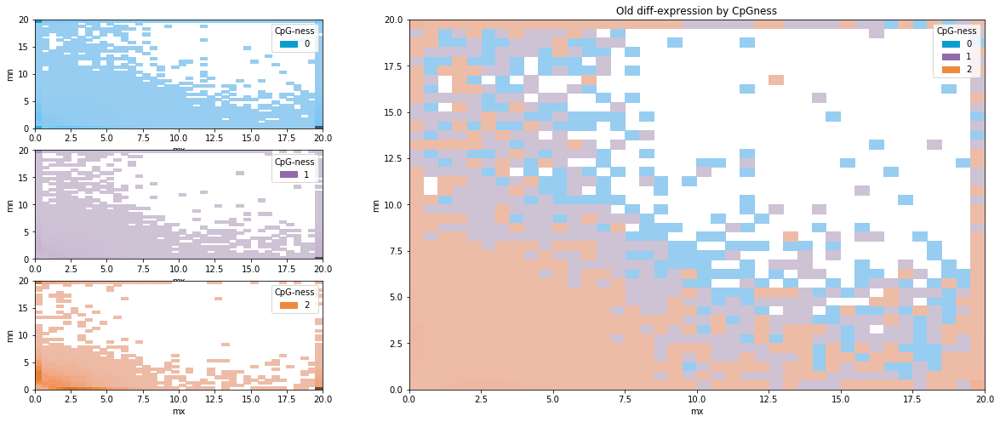

In [27]:
diffcols = [c for c in export.columns if c.endswith('-mean-log-diff')]
neo_para_old = export[(export['g1']<export['g2'])&(export['Branch point'].isin(["Opisthokonta", "Bilateria"]))]
neo_para_old = neo_para_old.set_index(['g1','g2'])
neo_para_old = neo_para_old.assign(mx=neo_para_old[diffcols].max(axis=1), mn=-neo_para_old[diffcols].min(axis=1))[['mx', 'mn', 'CpG-ness']]



fig, ax = pyplot.subplots(figsize=(20,8), nrows=3, ncols=2, gridspec_kw={'width_ratios':[1,2]})
histplot(ax=ax[0,0], data=neo_para_old[(neo_para_old['mx']>=0) & (neo_para_old['mn']>=0) & (neo_para_old['CpG-ness']==0)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#0B9DCF'])
histplot(ax=ax[1,0], data=neo_para_old[(neo_para_old['mx']>=0) & (neo_para_old['mn']>=0) & (neo_para_old['CpG-ness']==1)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#926AA5'])
histplot(ax=ax[2,0], data=neo_para_old[(neo_para_old['mx']>=0) & (neo_para_old['mn']>=0) & (neo_para_old['CpG-ness']==2)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#EF893D'])
gs = ax[0, 1].get_gridspec()
for a in ax[:, -1]:
  a.remove()
axbig = fig.add_subplot(gs[:, -1])

histplot(ax=axbig, data=neo_para_old[(neo_para_old['mx']>=0) & (neo_para_old['mn']>=0)], x='mx', y='mn',hue='CpG-ness', bins=(40,40), palette=['#0B9DCF','#926AA5','#EF893D'])
title('Old diff-expression by CpGness')
plt.savefig('mouse-diff-expression-old.pdf', dpi=600)

In [29]:
from scipy.stats import mannwhitneyu
print('Recent: %s'%str(mannwhitneyu((abs(neo_para_recent.dropna()['mn'])+abs(neo_para_recent.dropna()['mx']))[neo_para_recent.dropna()['CpG-ness']==0],(abs(neo_para_recent.dropna()['mn'])+abs(neo_para_recent.dropna()['mx']))[neo_para_recent.dropna()['CpG-ness']==2], alternative='two-sided')))
print('Mid: %s'%str(mannwhitneyu((abs(neo_para_mid.dropna()['mn'])+abs(neo_para_mid.dropna()['mx']))[neo_para_mid.dropna()['CpG-ness']==0],(abs(neo_para_mid.dropna()['mn'])+abs(neo_para_mid.dropna()['mx']))[neo_para_mid.dropna()['CpG-ness']==2], alternative='two-sided')))
print('Old: %s'%str(mannwhitneyu((abs(neo_para_old.dropna()['mn'])+abs(neo_para_old.dropna()['mx']))[neo_para_old.dropna()['CpG-ness']==0],(abs(neo_para_old.dropna()['mn'])+abs(neo_para_old.dropna()['mx']))[neo_para_old.dropna()['CpG-ness']==2], alternative='two-sided')))

ERROR! Session/line number was not unique inRecent: MannwhitneyuResult(statistic=3136028.5, pvalue=2.1781544662345777e-11)
 database. History logging moved to new session 264
Mid: MannwhitneyuResult(statistic=18177866.0, pvalue=0.0)
Old: MannwhitneyuResult(statistic=385646288.5, pvalue=0.0)


In [41]:
pickle.dump(canons, open('/data/db/import/save/mouse-canons.pkl', 'wb'))
pickle.dump(export, open('/data/db/import/save/mouse-export.pkl', 'wb'))
pickle.dump(mean_tpm, open('/data/db/import/save/mouse-mean_tpm.pkl', 'wb'))
pickle.dump(frexpr, open('/data/db/import/save/mouse-frexpr.pkl', 'wb'))
#pickle.dump(fact_diff_frame, open('/data/db/import/save/mouse-fact_diff_frame.pkl', 'wb'))
#pickle.dump(fact_diff_frames[500], open('/data/db/import/save/mouse-fact_diff_frames_500.pkl', 'wb'))
#pickle.dump(fact_diff_frames[1000], open('/data/db/import/save/mouse-fact_diff_frames_1000.pkl', 'wb'))
#pickle.dump(fact_diff_frames[2000], open('/data/db/import/save/mouse-fact_diff_frames_2000.pkl', 'wb'))
pickle.dump(genexpr, open('/data/db/import/save/mouse-genexpr.pkl', 'wb'))
pickle.dump(genentropy, open('/data/db/import/save/mouse-genentropy.pkl', 'wb'))
pickle.dump(exp_genes, open('/data/db/import/save/mouse-exp_genes.pkl', 'wb'))
#pickle.dump(filt_neo_para, open('/data/db/import/save/mouse-neo_para-big.pkl', 'wb'))
#pickle.dump(cluster, open('/data/db/import/save/mouse-cluster-big.pkl', 'wb'))

NameError: name 'exp_genes' is not defined

In [201]:
from seaborn import violinplot, despine, boxplot, barplot
from pandas import DataFrame
from matplotlib import pyplot
from itertools import chain
species = set(chain(*o2os.values()))
cpg_less_elife = set(['gene:'+x for x in exp_genes[exp_genes['mm_elife_overlaps']==0].index])
cpg_full_elife = set(['gene:'+x for x in exp_genes[exp_genes['mm_elife_overlaps']==1].index])

frameo=DataFrame.from_records([(bo, len([g for g in cpg_less if bo in o2os[g]])/len(cpg_less), 0) for bo in species]+
                             [(bo, len([g for g in cpg_full if bo in o2os[g]])/len(cpg_full), 1) for bo in species], columns=['Species', 'Orthologs', 'CpG-ness'])
frameo=frameo.sort_values("Orthologs", ascending=False)
frameelife=DataFrame.from_records([(bo, len([g for g in cpg_less_elife if g in o2os and bo in o2os[g]])/len(cpg_less_elife), 0) for bo in species]+
                             [(bo, len([g for g in cpg_full_elife if g in o2os and bo in o2os[g]])/len(cpg_full_elife), 1) for bo in species], columns=['Species', 'Orthologs', 'CpG-ness'])
frameelife=frameelife.sort_values("Orthologs", ascending=False)


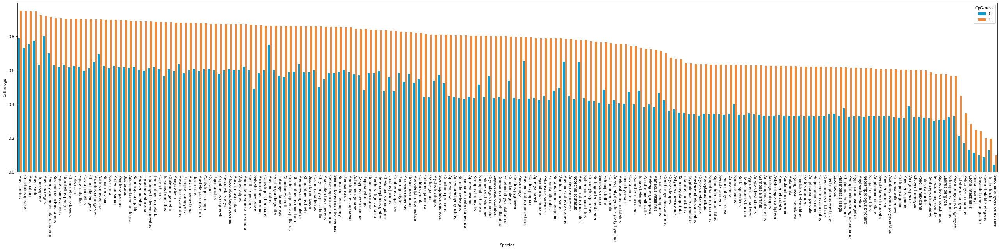

In [202]:
fig, ax = pyplot.subplots(figsize=(45,8))
pyplot.xticks(rotation=-90)
barplot(ax=ax, data=frameo, x="Species", y="Orthologs", hue="CpG-ness", saturation=1.0, palette = ['#0B9DCF', '#EF893D'])
fig.savefig('ortho-one-to-one-species-mouse-by-cgi-bars.pdf')

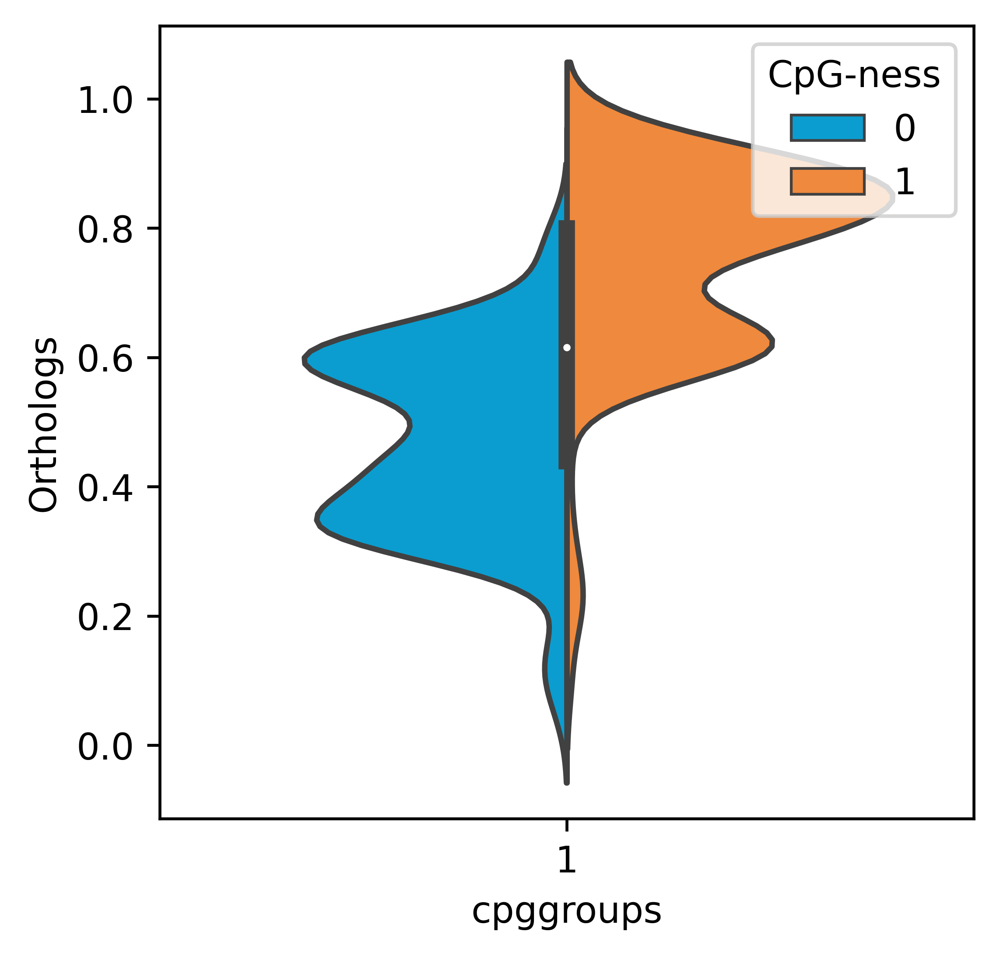

In [203]:
from seaborn import violinplot
fig,ax = pyplot.subplots(figsize=(4,4), dpi=600)
violinplot(ax=ax, data=frameo.assign(cpggroups=1), x="cpggroups", y="Orthologs", hue="CpG-ness", split=True, saturation=1.0, palette = ['#0B9DCF', '#EF893D'])
fig.savefig('ortho-one-to-one-species-mouse-by-cgi-violin.pdf')

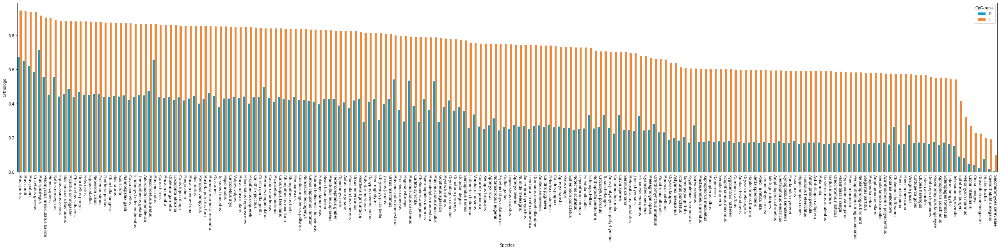

In [204]:
fig, ax = pyplot.subplots(figsize=(45,8))
pyplot.xticks(rotation=-90)
barplot(ax=ax, data=frameelife, x="Species", y="Orthologs", hue="CpG-ness", saturation=1.0, palette = ['#0B9DCF', '#EF893D'])
fig.savefig('ortho-one-to-one-species-mouse-by-cgi-bars-elife.pdf')

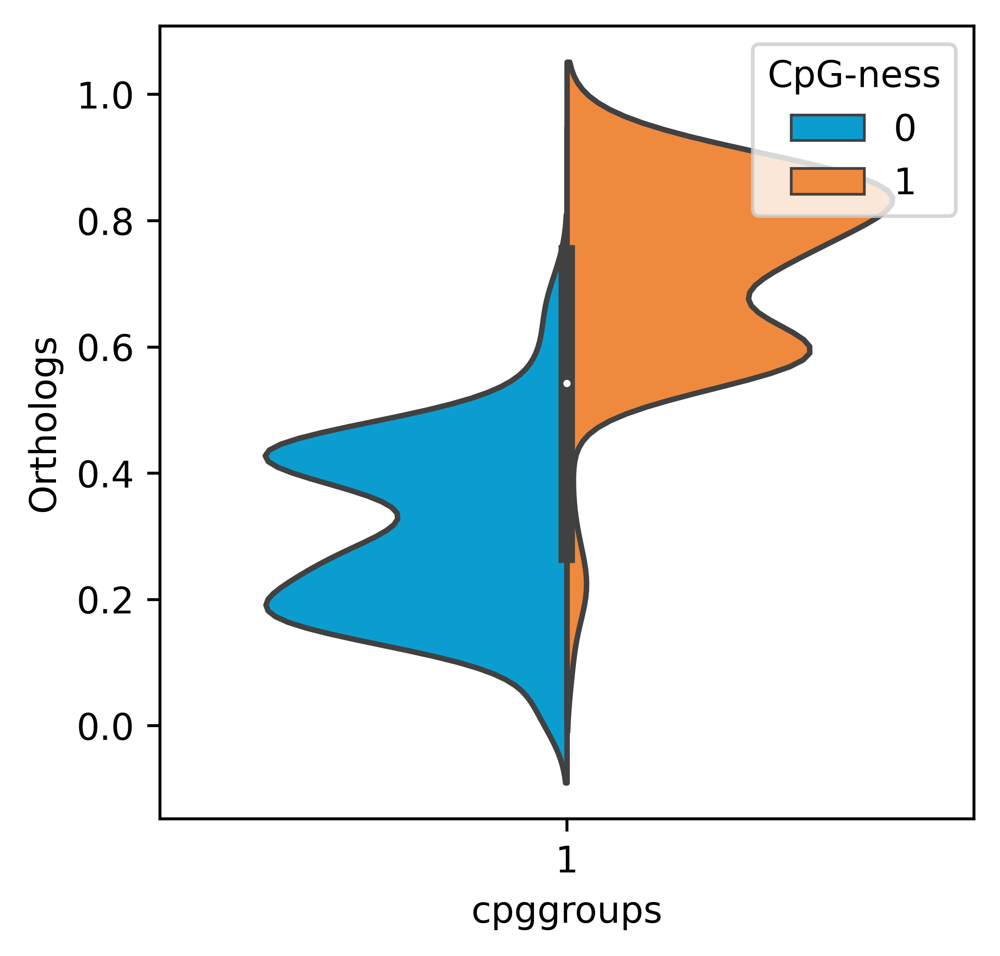

In [205]:
from seaborn import violinplot
fig,ax = pyplot.subplots(figsize=(4,4), dpi=600)
violinplot(ax=ax, data=frameelife.assign(cpggroups=1), x="cpggroups", y="Orthologs", hue="CpG-ness", split=True, saturation=1.0, palette = ['#0B9DCF', '#EF893D'])
fig.savefig('ortho-one-to-one-species-mouse-by-cgi-violin-elife.pdf')

In [37]:
list(export.columns)

['Branch point',
 'CpG-ness',
 'dN',
 'dS',
 'Similarity',
 'Length',
 'Distance',
 'g1',
 'g2',
 'dSbin',
 'pearson_corr',
 'euclidean_corr',
 'featuretype',
 'expr_corr_factor',
 'expr_corr_pval',
 'first_intron-g1',
 'introns-g1',
 'first_intron-g2',
 'introns-g2',
 'change',
 'fold',
 'mutual',
 'mut-pct',
 'factors-g1',
 'factors-g2',
 'change-500',
 'fold-500',
 'mutual-500',
 'mut-pct-500',
 'factors-g1-500',
 'factors-g2-500',
 'change-1000',
 'fold-1000',
 'mutual-1000',
 'mut-pct-1000',
 'factors-g1-1000',
 'factors-g2-1000',
 'change-2000',
 'fold-2000',
 'mutual-2000',
 'mut-pct-2000',
 'factors-g1-2000',
 'factors-g2-2000',
 'adrenal gland-female-tpm-g1-tpm',
 'adrenal gland-male-tpm-g1-tpm',
 'bone marrow-female-tpm-g1-tpm',
 'bone marrow-male-tpm-g1-tpm',
 'brain-female-tpm-g1-tpm',
 'brain-male-tpm-g1-tpm',
 'forestomach-female-tpm-g1-tpm',
 'forestomach-male-tpm-g1-tpm',
 'heart-female-tpm-g1-tpm',
 'heart-male-tpm-g1-tpm',
 'kidney-female-tpm-g1-tpm',
 'kidney-male-tp

In [45]:
exprcols=[c for c in export.columns if c.endswith('-tpm')]
exprnorm = export.assign(avgexpr = export[exprcols].mean(axis=1))

In [46]:
one_to_one_matches(exprnorm[(exprnrom['Branch point'] == b)&(exprnorm['avgexpr'].notna()) & (retframe['CpG-ness'] == 0)],
                   exprnorm[(exprnrom['Branch point'] == b)&(exprnorm['avgexpr'].notna()) & (retframe['CpG-ness'] == 2)], 'avgexpr', 0.1) in b in branch_order:
    

0         12.041055
1         12.041055
2         10.252107
3         10.252107
4          6.636187
            ...    
713131     0.622121
713132     0.690392
713133     0.690392
713134     0.745987
713135     0.745987
Name: avgexpr, Length: 713136, dtype: float64

In [47]:
pickle.dump(tfbm_scores, open('/data/db/import/save/mouse-tfbm-scores.pkl', 'wb'))
pickle.dump(tfbm_scores_pct, open('/data/db/import/save/mouse-tfbm-scores-pct.pkl', 'wb'))